In [1]:
library(igraph)


Attaching package: ‘igraph’

The following objects are masked from ‘package:stats’:

    decompose, spectrum

The following object is masked from ‘package:base’:

    union



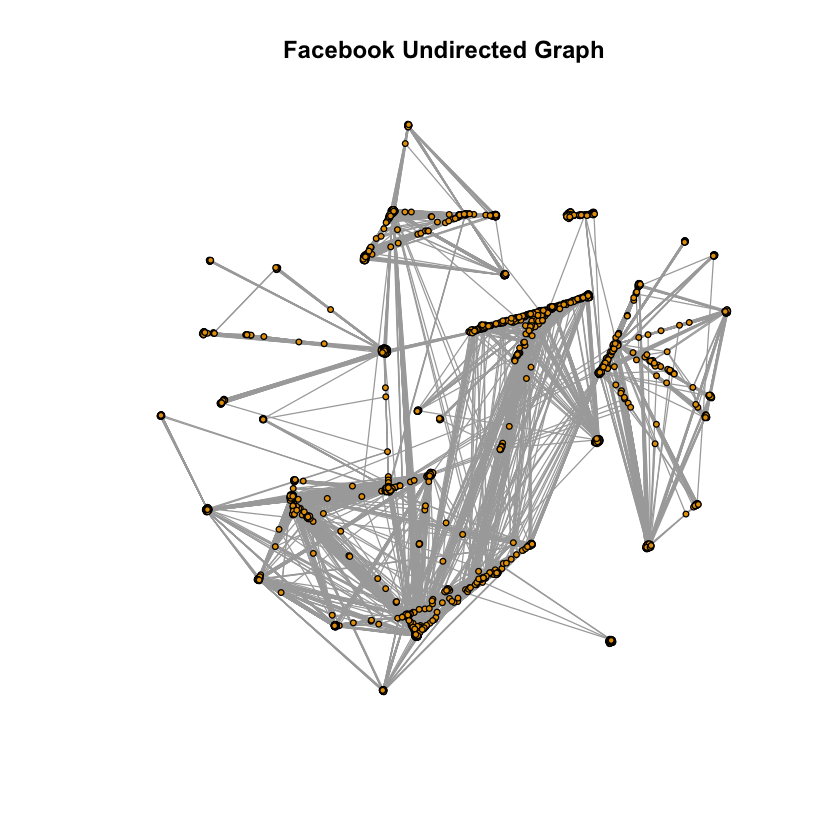

In [3]:
edges <- read.table("facebook_combined.txt")
facebook_graph <- graph.data.frame(edges, directed=FALSE)
plot(facebook_graph,
     vertex.label=NA,
     vertex.size=2,
     main = "Facebook Undirected Graph"
)

# QUESTION 1

1.1

In [3]:
sprintf("Number of nodes: %d",gorder(facebook_graph))
sprintf("Number of edges: %d", gsize(facebook_graph))

[1] "Number of nodes: 4039"

[1] "Number of edges: 88234"

1.2

In [4]:
is_connected(facebook_graph)

[1] TRUE

# QUESTION 2

In [5]:
diameter(facebook_graph)

[1] 8

# QUESTION 3

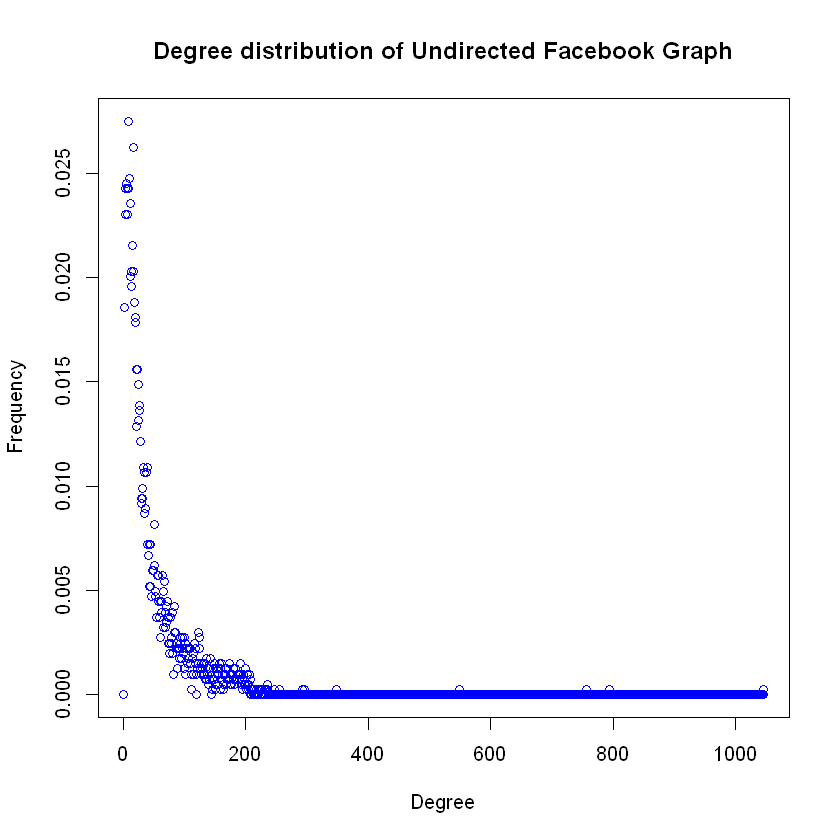

In [6]:
degree <- degree.distribution(facebook_graph)
plot(degree, col="blue",main="Degree distribution of Undirected Facebook Graph",xlab="Degree",ylab="Frequency")

In [7]:
print(mean(degree(facebook_graph)))

[1] 43.69101


# QUESTION 4

[1] "Slope and intercept for the line"

Call:
lm(formula = logDistribution ~ logDegree)

Coefficients:
(Intercept)    logDegree  
    -0.9537      -1.2475  



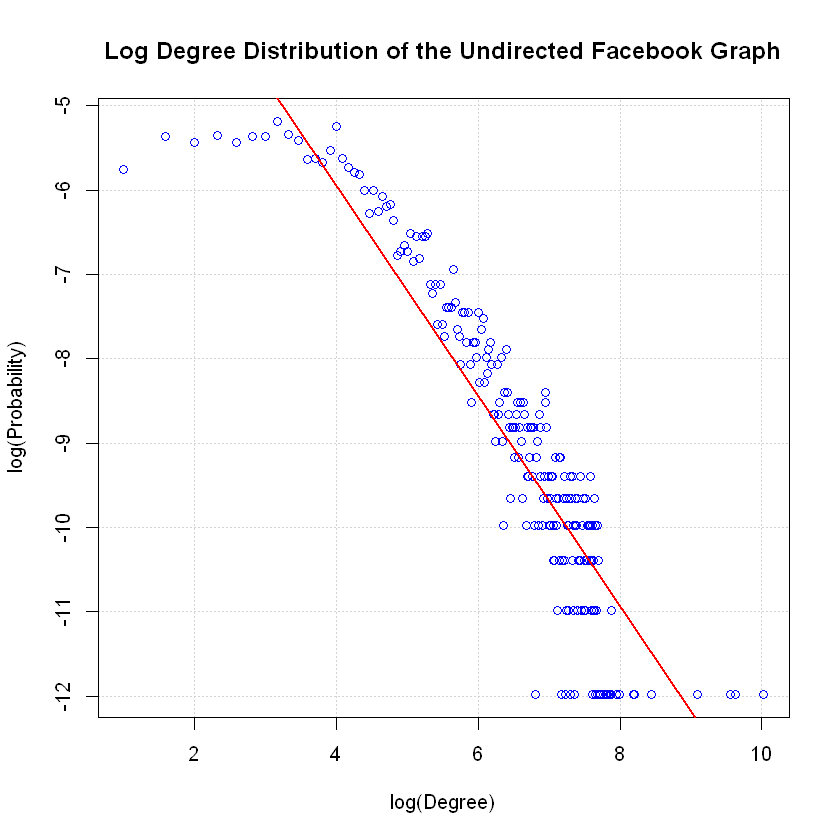

In [8]:
degreeDistribution = degree.distribution(facebook_graph)
logDegree <- log2(c(1:length(degreeDistribution)))[which(degreeDistribution !=0, arr.ind = TRUE)]
logDistribution <- log2(degreeDistribution)[which(degreeDistribution !=0, arr.ind = TRUE)]    
plot(logDegree, logDistribution,
    main=sprintf("Log Degree Distribution of the Undirected Facebook Graph"),
    xlab="log(Degree)",
    ylab="log(Probability)",
    grid(),
    col="blue"
)
abline(lm(logDistribution ~ logDegree),col="red",lwd=2)
print("Slope and intercept for the line")
print(lm(logDistribution ~ logDegree))

# QUESTION 5

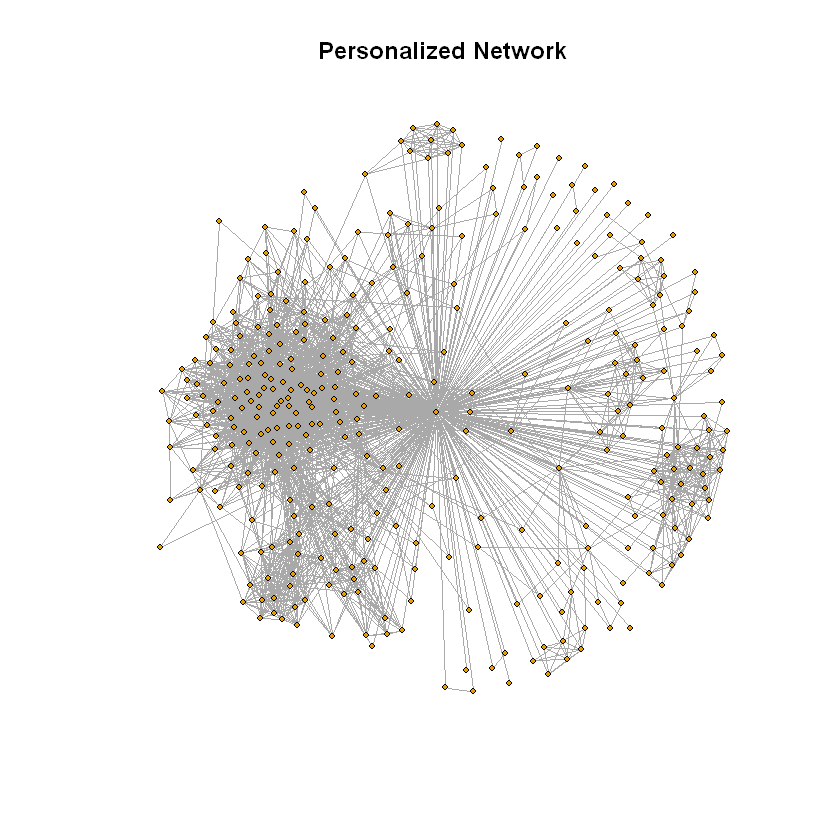

In [9]:
allPersonalizedNetworks = make_ego_graph(facebook_graph, nodes = V(facebook_graph))
personalizedNetwork <- allPersonalizedNetworks[[1]]
plot(personalizedNetwork,
     vertex.label=NA,
     vertex.size=2,
     main = "Personalized Network"
)

In [10]:
sprintf("Number of nodes: %d",gorder(personalizedNetwork))
sprintf("Number of edges: %d", gsize(personalizedNetwork))

[1] "Number of nodes: 348"

[1] "Number of edges: 2866"

# QUESTION 6

In [11]:
diameter(personalizedNetwork)

[1] 2

# QUESTION 8

In [12]:
core_nodes <- numeric()
for (node in V(facebook_graph)) {
  if (length(neighbors(facebook_graph, node)) > 200)
    core_nodes <- c(core_nodes, node)
}

In [13]:
core_degrees <- degree(facebook_graph, core_nodes)

In [14]:
sprintf("Number of core nodes: %d", length(core_nodes))
sprintf("Average degree of core nodes: %f", mean(core_degrees))

[1] "Number of core nodes: 40"

[1] "Average degree of core nodes: 279.375000"

# QUESTION 9

In [4]:
node_list <- c(1,108,349,484,1087)
facebook_graph <- read.graph("facebook_combined.txt", format="edgelist", directed=FALSE)
PersonalizedNetworks <- make_ego_graph(facebook_graph, order = 1, nodes = V(facebook_graph)[node_list])

In [16]:
communityStructure <- function(i) {
    thispersonalizedNetwork <- PersonalizedNetworks[[i]]
    fast_greedy <- cluster_fast_greedy(thispersonalizedNetwork)
    edge_between <- cluster_edge_betweenness(thispersonalizedNetwork)
    infomap <- cluster_infomap(thispersonalizedNetwork)
    print("------------------------------------------------")
    print(sprintf("Modularities for Core Node %d's personalized network", node_list[i]))
    print("------------------------------------------------")
    print(sprintf("Fast Greedy: %f", modularity(fast_greedy)))
    print(sprintf("Edge-Betweenness: %f", modularity(edge_between)))
    print(sprintf("Infomap: %f", modularity(infomap)))
    plot(thispersonalizedNetwork,
         mark.groups = fast_greedy,
         vertex.size=2,
         vertex.color=fast_greedy$membership,
         vertex.label=NA,
         main = sprintf("Fast Greedy")
    )
    plot(thispersonalizedNetwork,
         mark.groups = edge_between,
         vertex.size=2,
         vertex.color=edge_between$membership,
         vertex.label=NA,
         main = sprintf("Edge Betweenness")
    )
    plot(thispersonalizedNetwork,
         mark.groups = infomap,
         vertex.size=2,
         vertex.color=infomap$membership,
         vertex.label=NA,
         main = sprintf("Infomap")
    )
    
}

[1] "------------------------------------------------"
[1] "Modularities for Core Node 1's personalized network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.413101"
[1] "Edge-Betweenness: 0.353302"
[1] "Infomap: 0.389118"


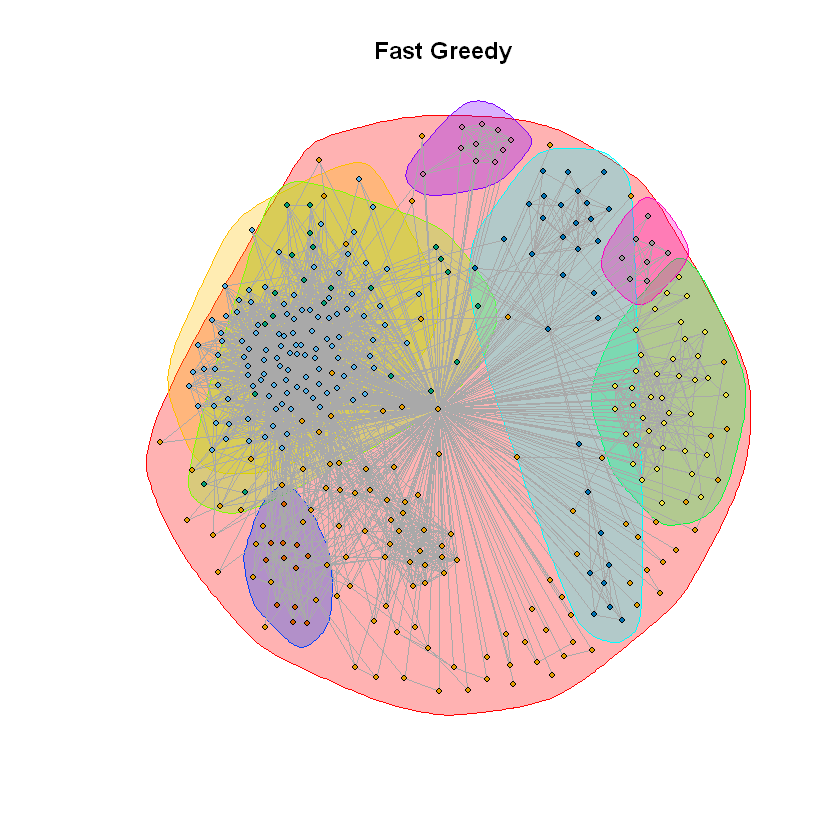

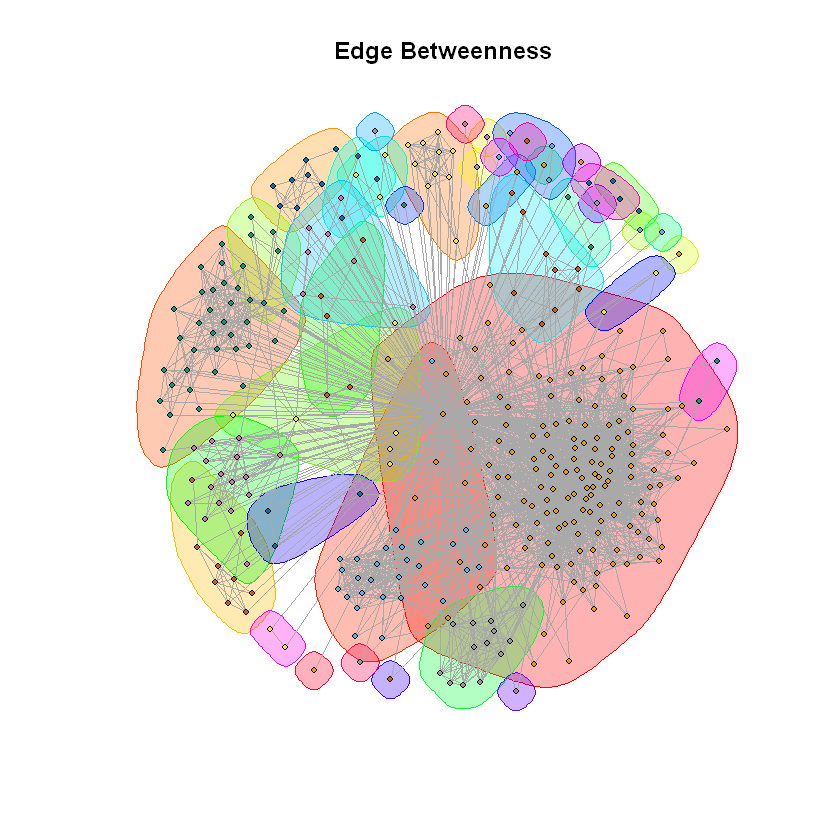

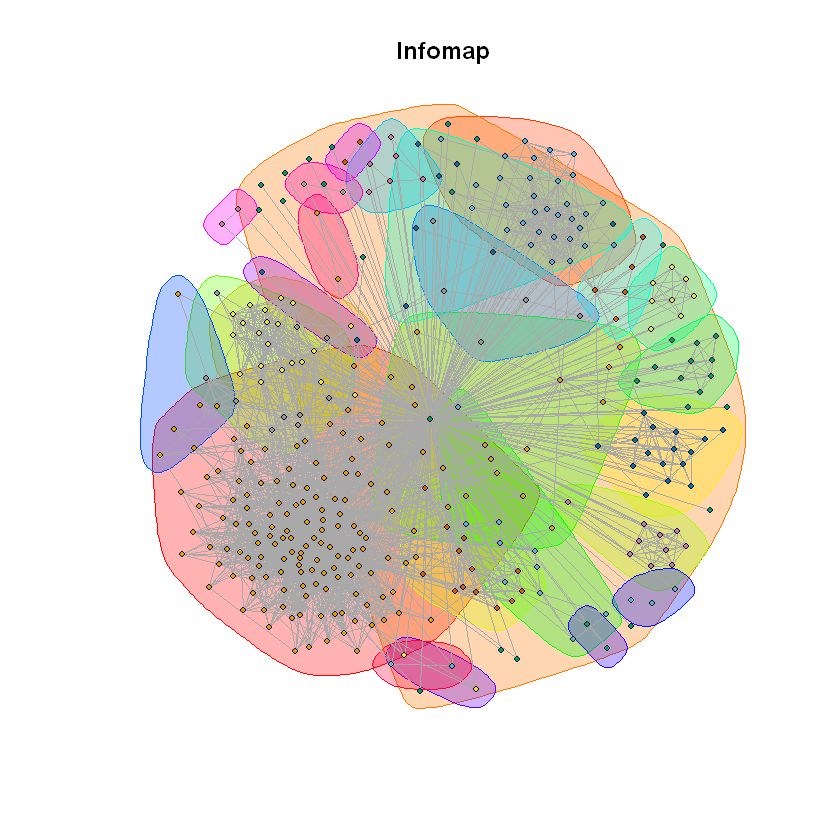

In [17]:
communityStructure(1)

[1] "------------------------------------------------"
[1] "Modularities for Core Node 108's personalized network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.435929"
[1] "Edge-Betweenness: 0.506755"
[1] "Infomap: 0.508454"


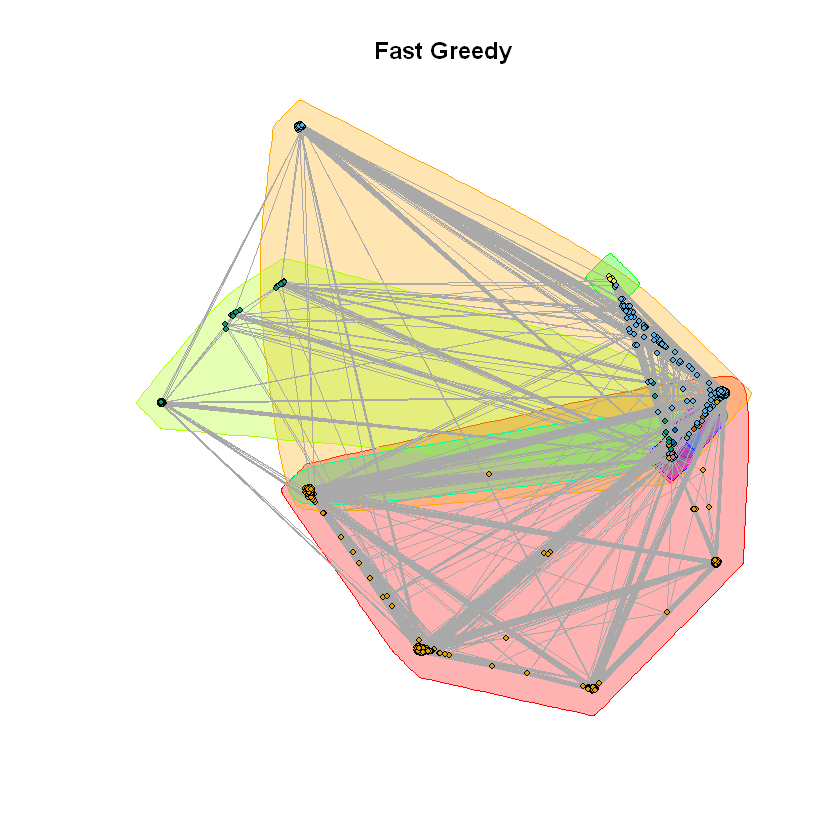

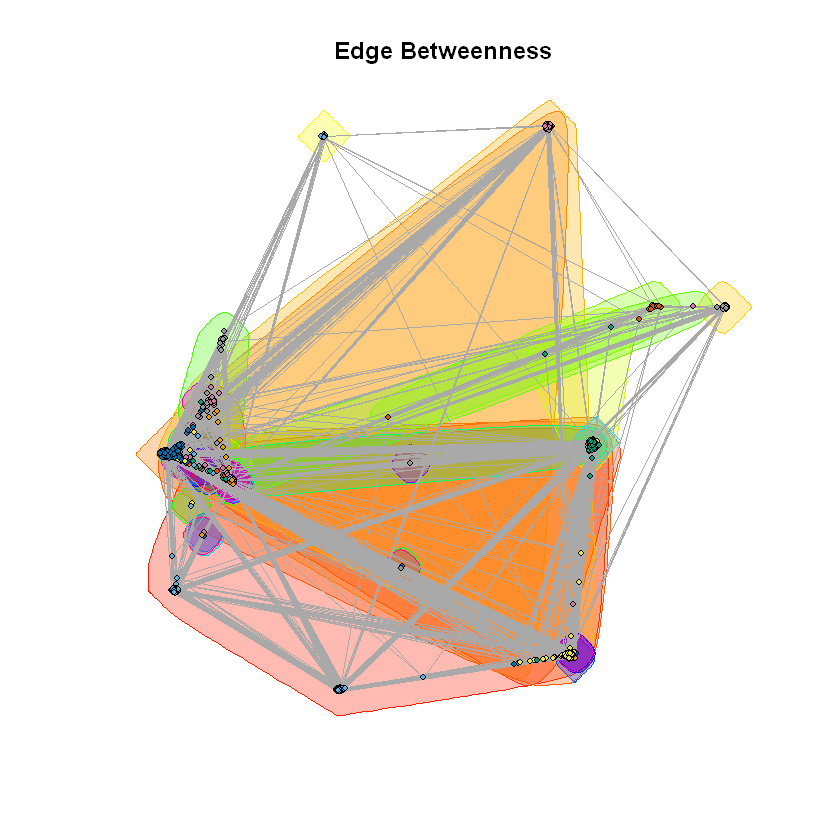

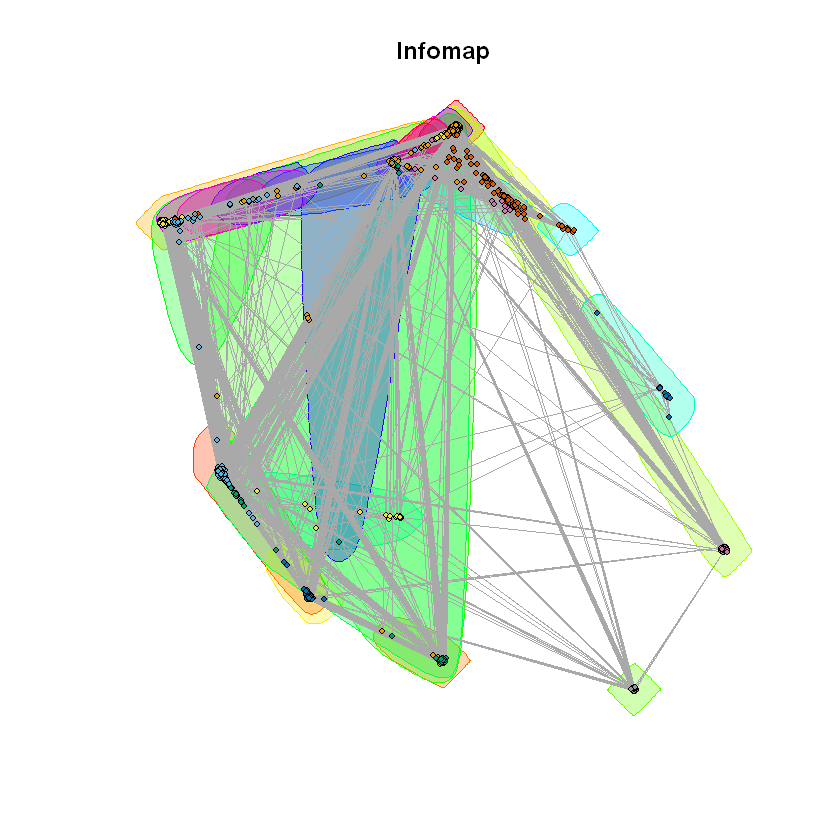

In [18]:
communityStructure(2)

[1] "------------------------------------------------"
[1] "Modularities for Core Node 349's personalized network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.251715"
[1] "Edge-Betweenness: 0.133528"
[1] "Infomap: 0.095464"


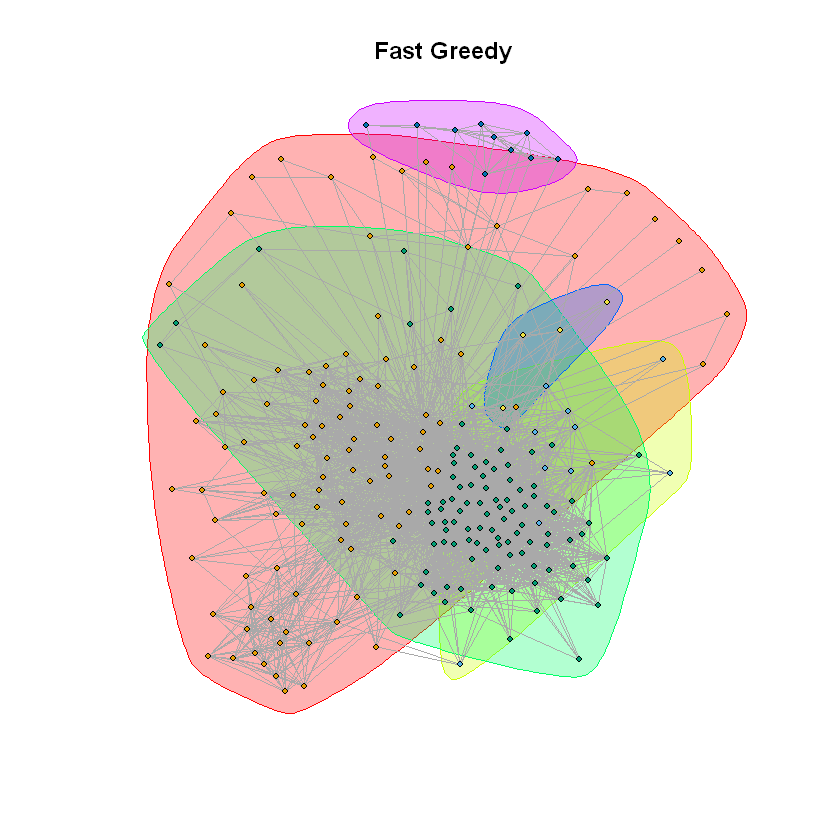

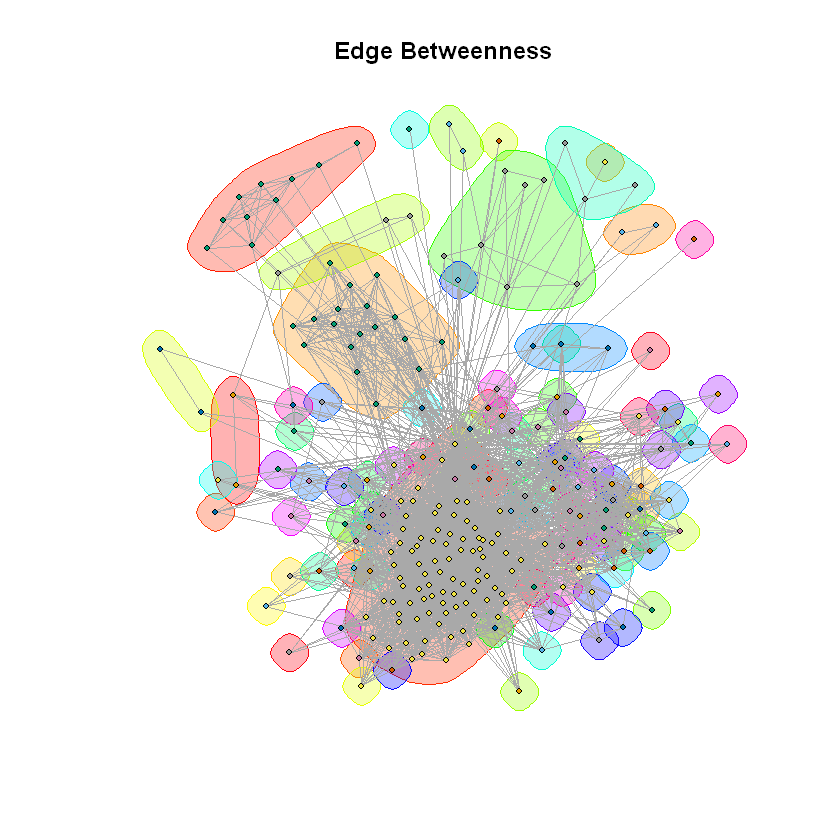

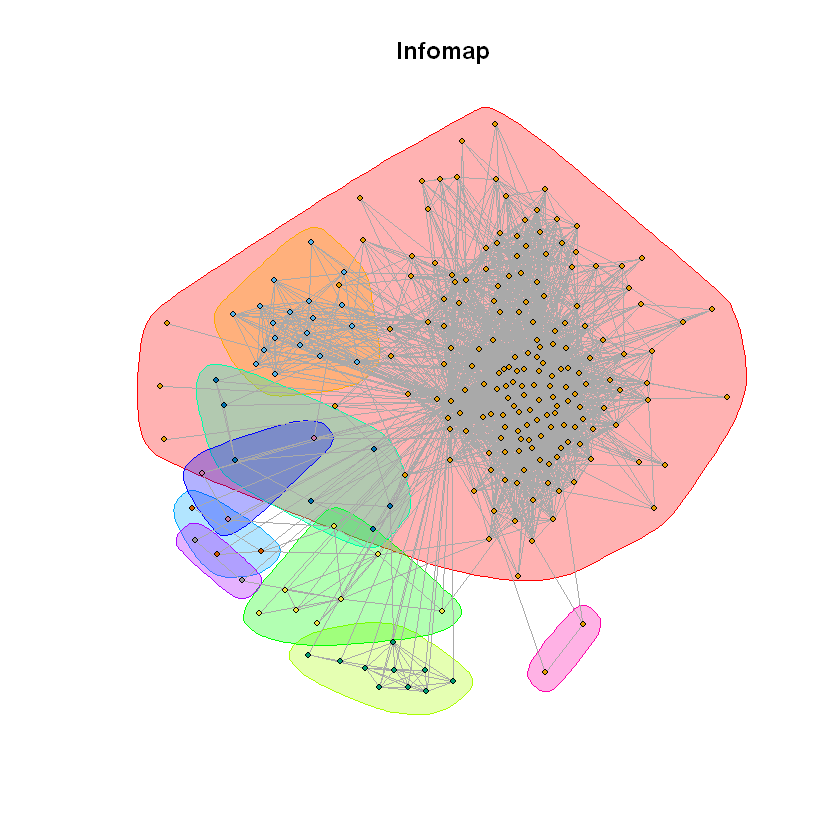

In [19]:
communityStructure(3)

[1] "------------------------------------------------"
[1] "Modularities for Core Node 484's personalized network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.507002"
[1] "Edge-Betweenness: 0.489095"
[1] "Infomap: 0.515279"


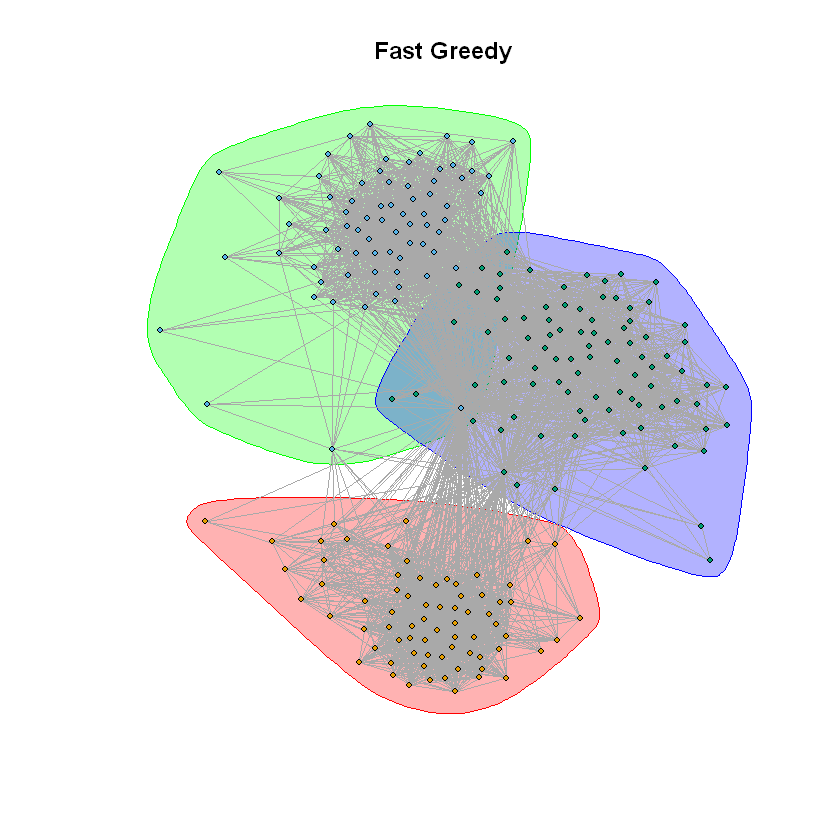

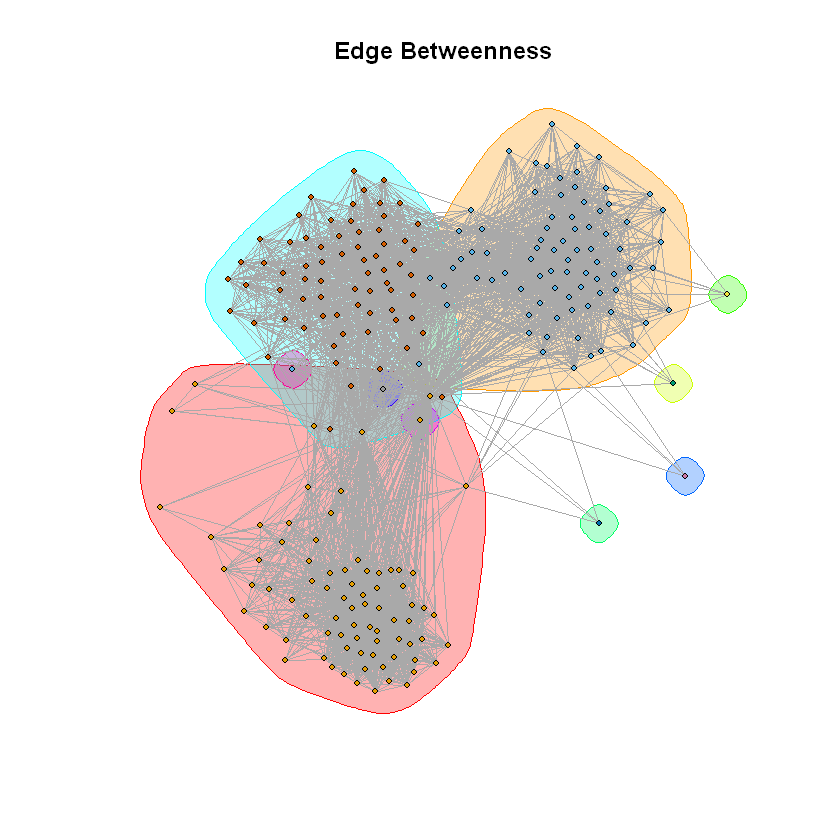

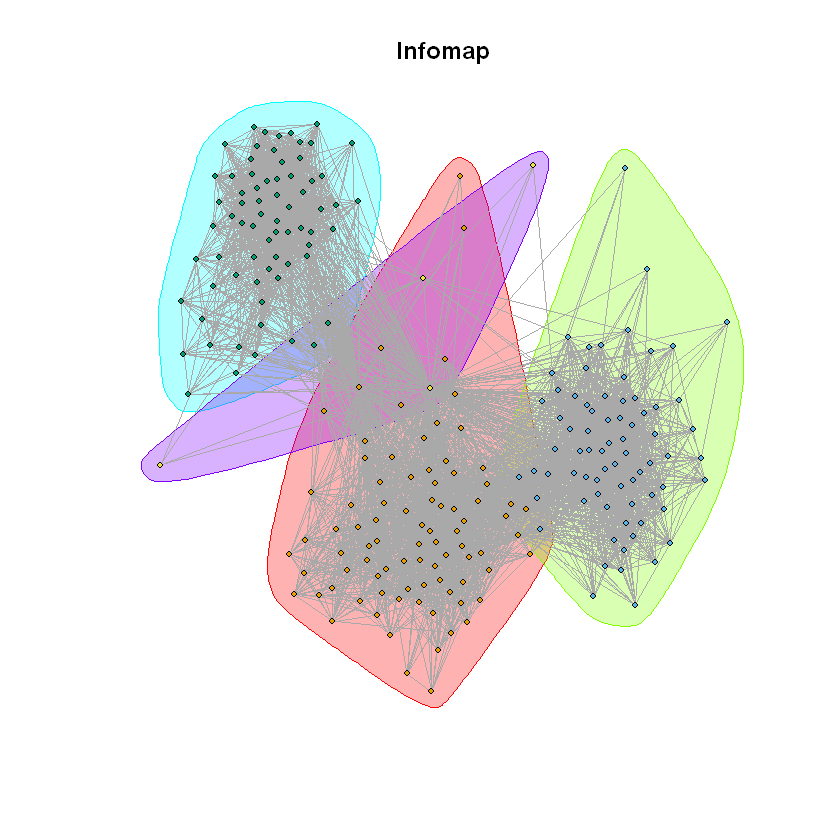

In [20]:
communityStructure(4)

[1] "------------------------------------------------"
[1] "Modularities for Core Node 1087's personalized network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.145531"
[1] "Edge-Betweenness: 0.027624"
[1] "Infomap: 0.026907"


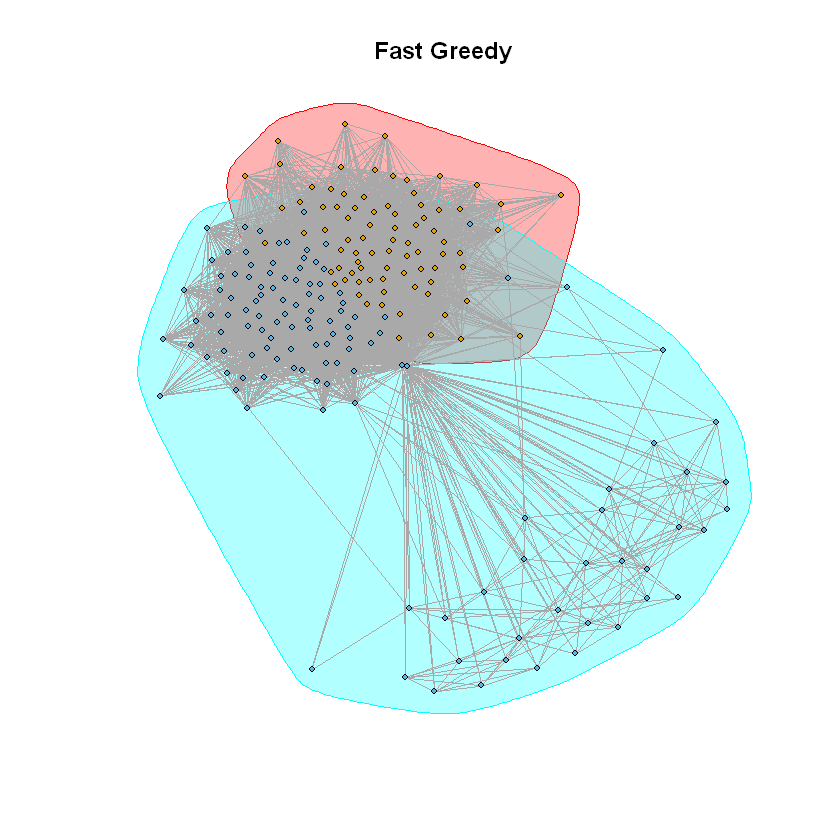

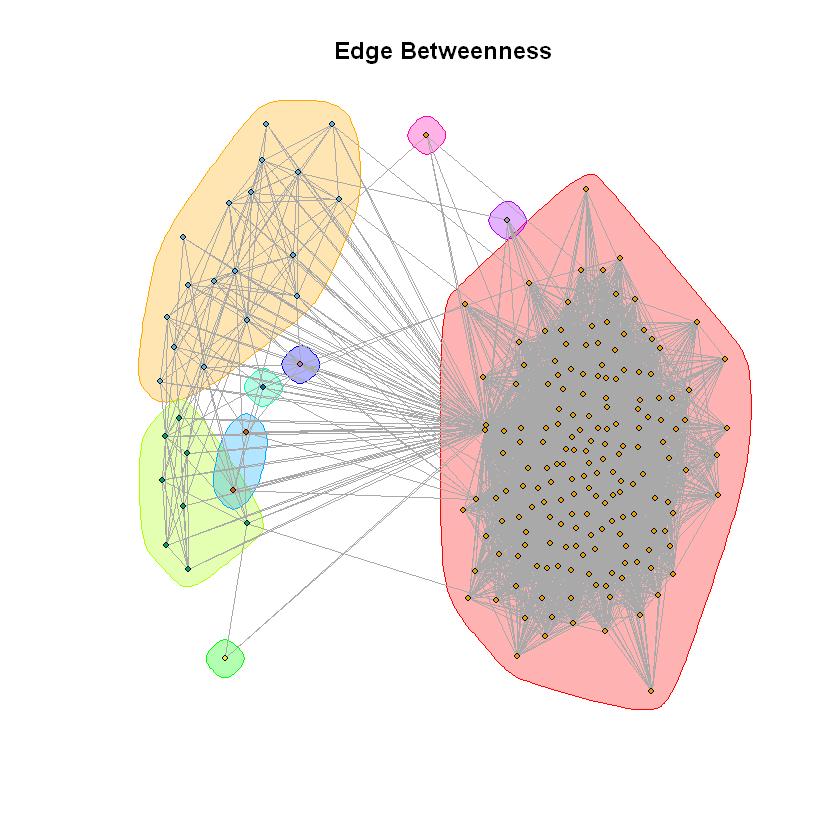

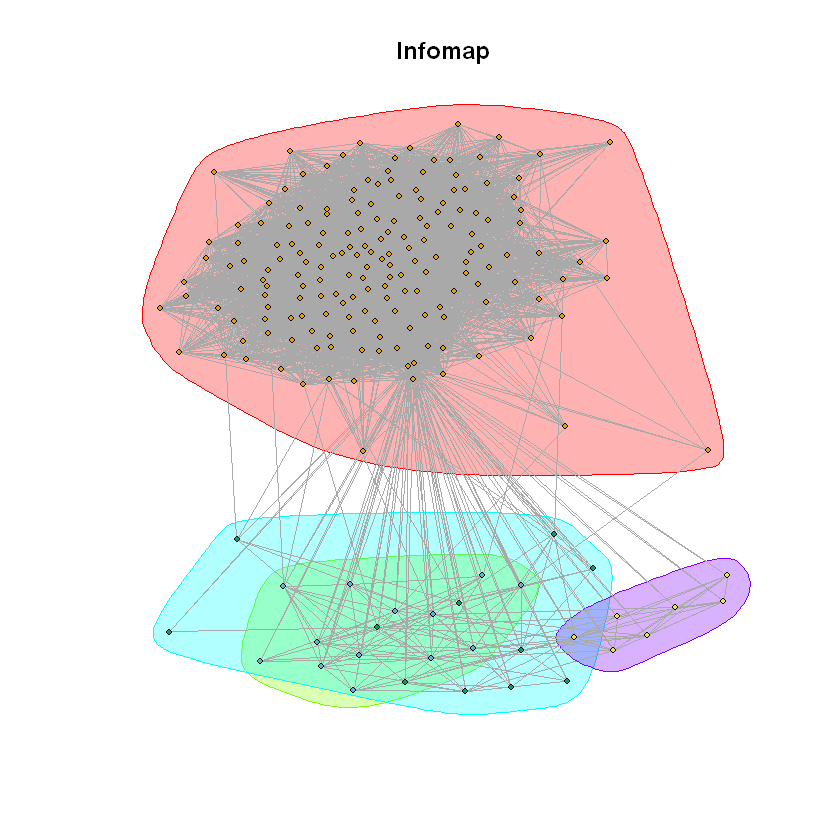

In [21]:
communityStructure(5)

# QUESTION 10

In [5]:
modifiedCommunityStructure <- function(i) {
    modifiedNetwork <- induced_subgraph(facebook_graph, neighbors(facebook_graph, node_list[i]))
    fast_greedy <- cluster_fast_greedy(modifiedNetwork)
    edge_between <- cluster_edge_betweenness(modifiedNetwork)
    infomap <- cluster_infomap(modifiedNetwork)
    print("------------------------------------------------")
    print(sprintf("Modularities for Core Node %d's modified Personalized Network", node_list[i]))
    print("------------------------------------------------")
    print(sprintf("Fast Greedy: %f", modularity(fast_greedy)))
    print(sprintf("Edge-Betweenness: %f", modularity(edge_between)))
    print(sprintf("Infomap: %f", modularity(infomap)))
    plot(PersonalizedNetworks[[i]],
         mark.groups = fast_greedy,
         vertex.size=2,
         vertex.color=fast_greedy$membership,
         vertex.label=NA,
         main = sprintf("Fast Greedy")
    )
    plot(PersonalizedNetworks[[i]],
         mark.groups = edge_between,
         vertex.size=2,
         vertex.color=edge_between$membership,
         vertex.label=NA,
         main = sprintf("Edge Betweenness")
    )
    plot(PersonalizedNetworks[[i]],
         mark.groups = infomap,
         vertex.size=2,
         vertex.color=infomap$membership,
         vertex.label=NA,
         main = sprintf("Infomap")
    )
    
}

[1] "------------------------------------------------"
[1] "Modularities for Core Node 1's modified Personalized Network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.441853"
[1] "Edge-Betweenness: 0.416146"
[1] "Infomap: 0.418008"


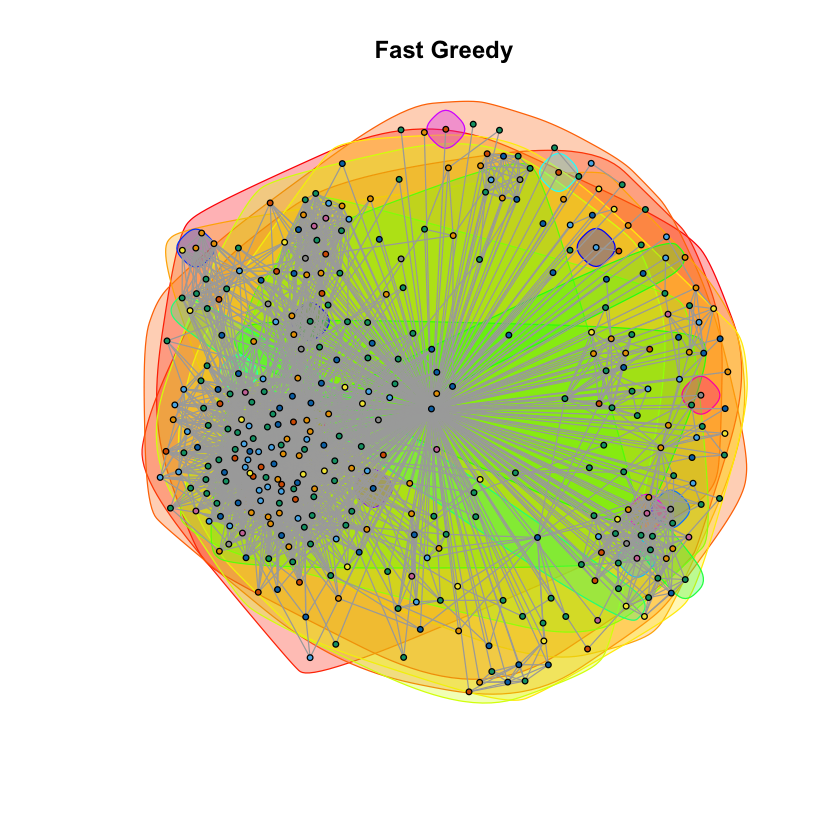

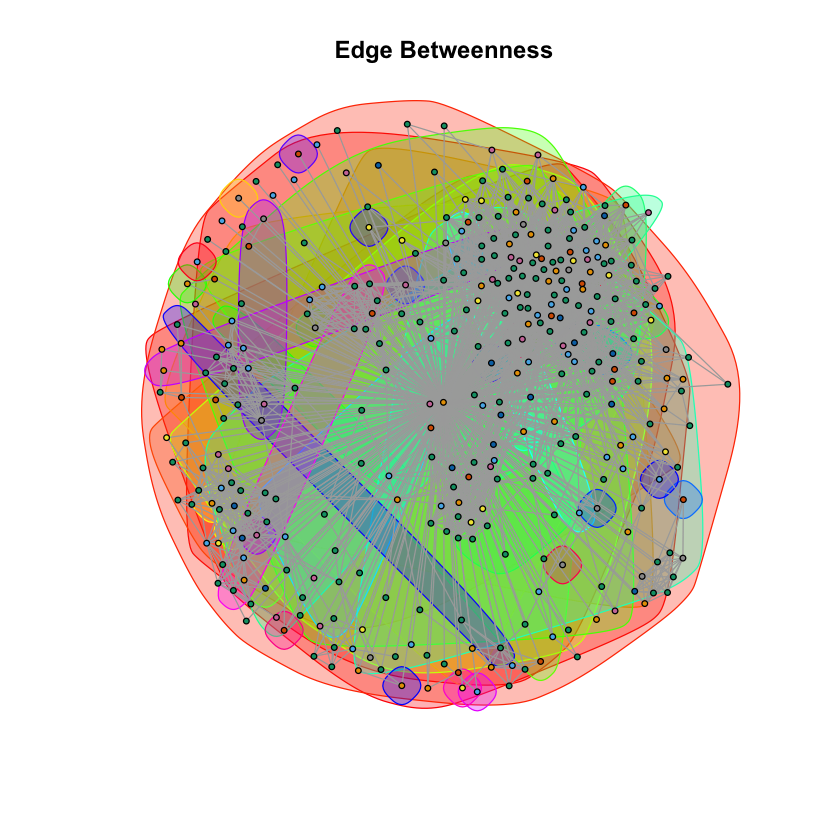

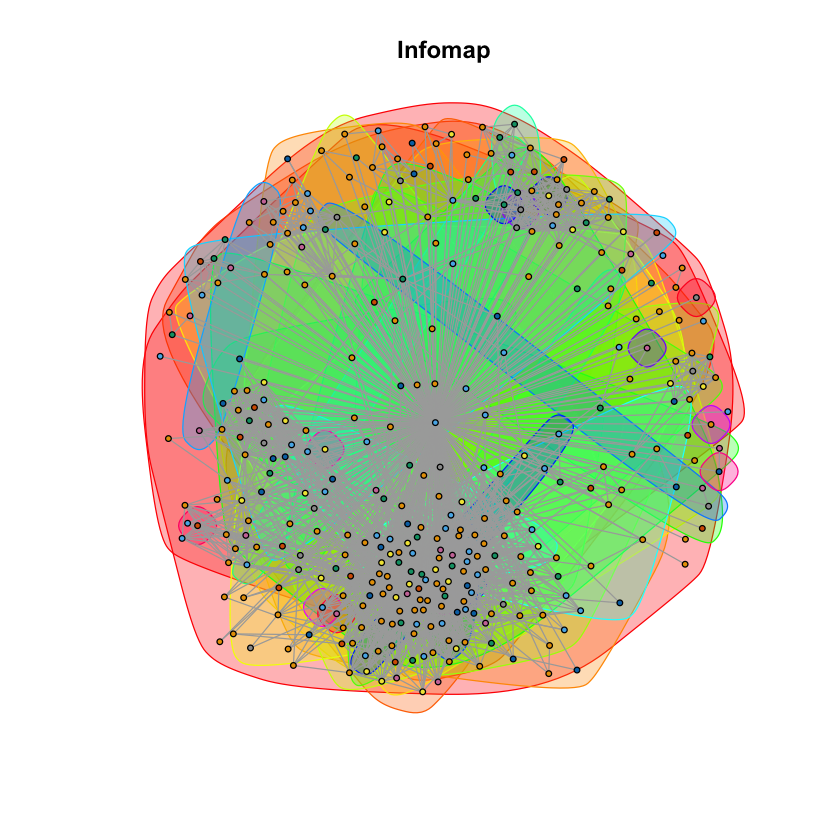

In [4]:
modifiedCommunityStructure(1)

[1] "------------------------------------------------"
[1] "Modularities for Core Node 108's modified Personalized Network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.458127"
[1] "Edge-Betweenness: 0.521322"
[1] "Infomap: 0.520961"


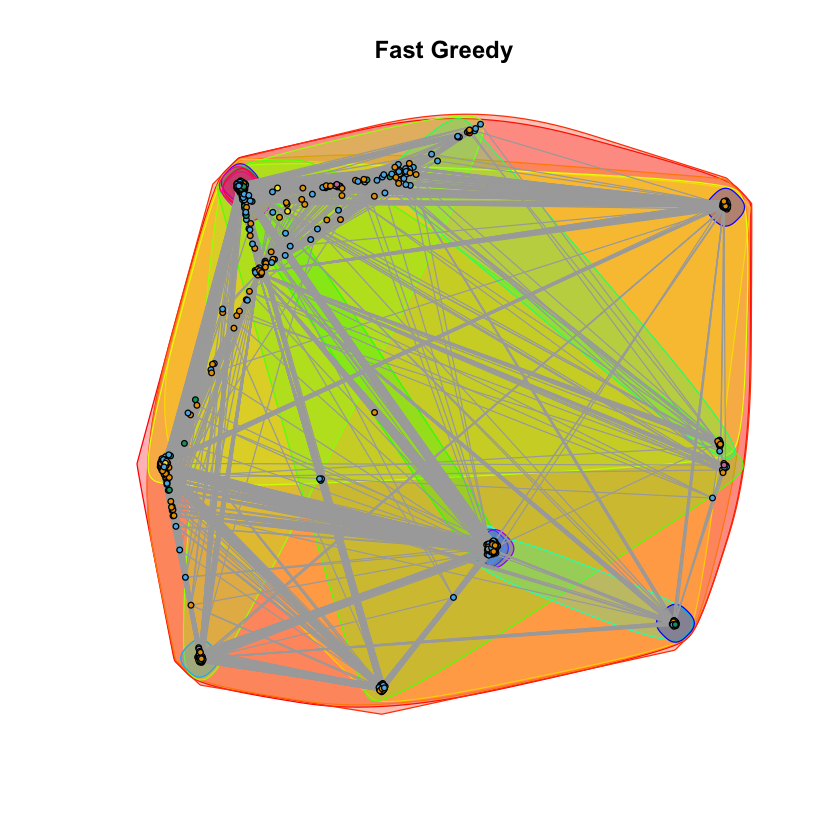

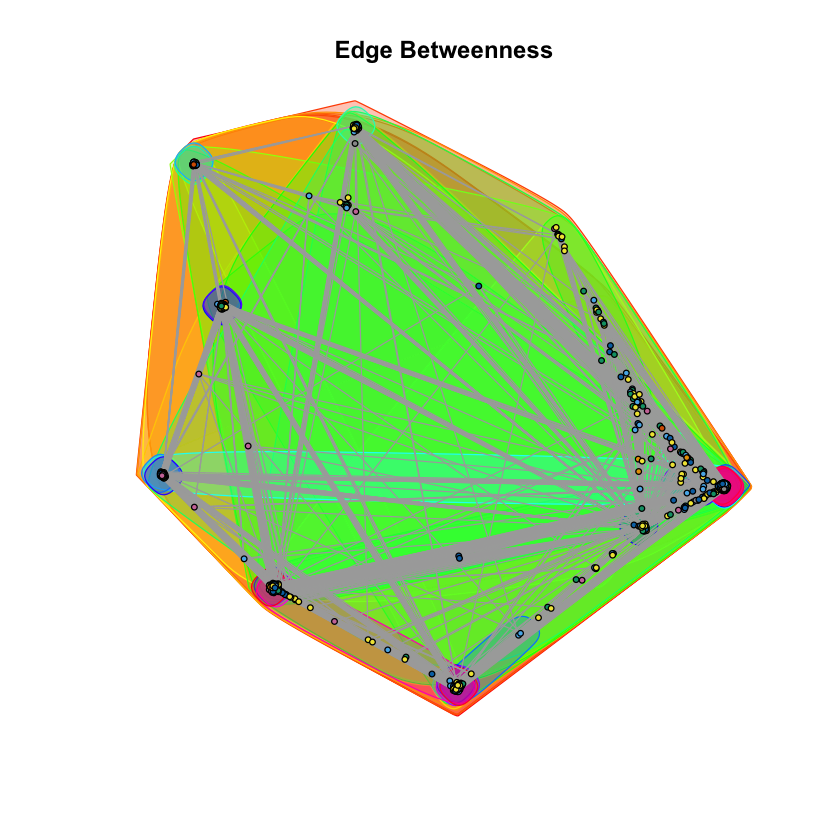

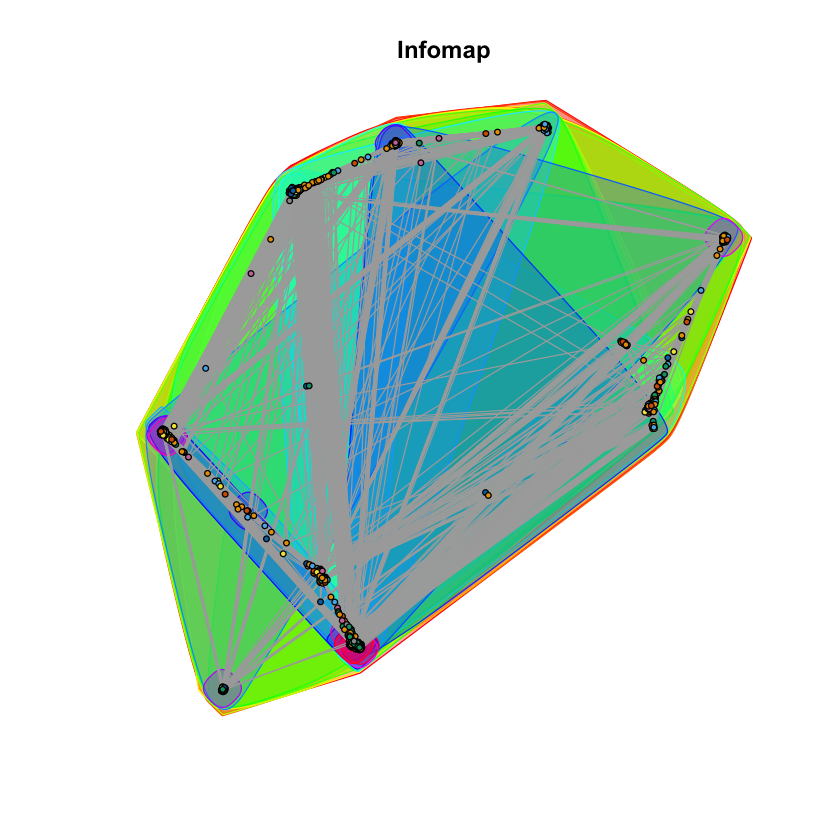

In [6]:
modifiedCommunityStructure(2)

[1] "------------------------------------------------"
[1] "Modularities for Core Node 349's modified Personalized Network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.245692"
[1] "Edge-Betweenness: 0.150566"
[1] "Infomap: 0.244816"


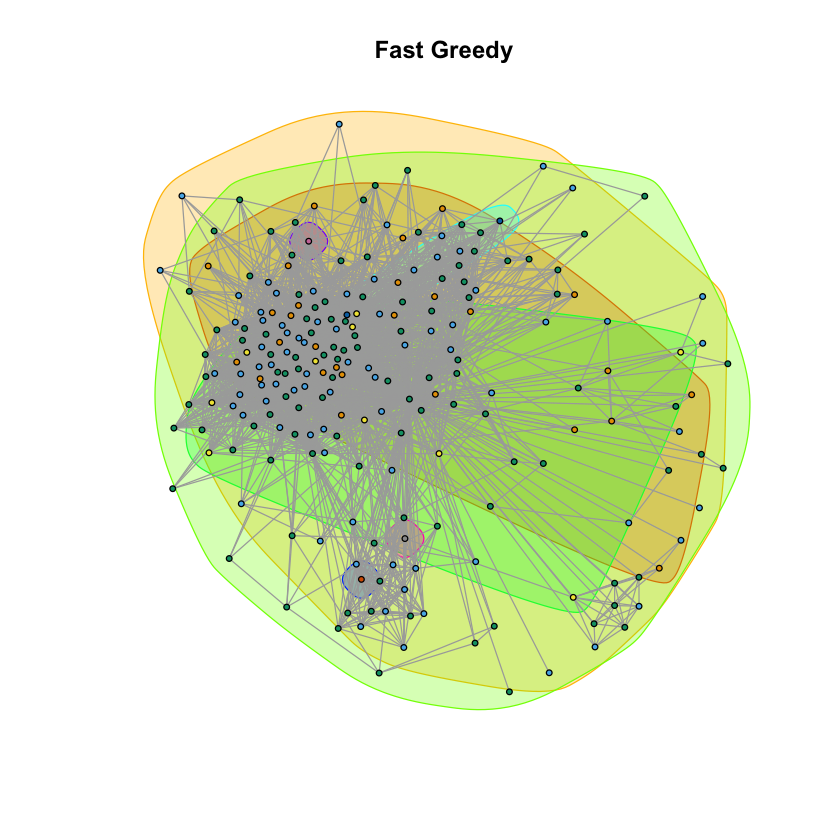

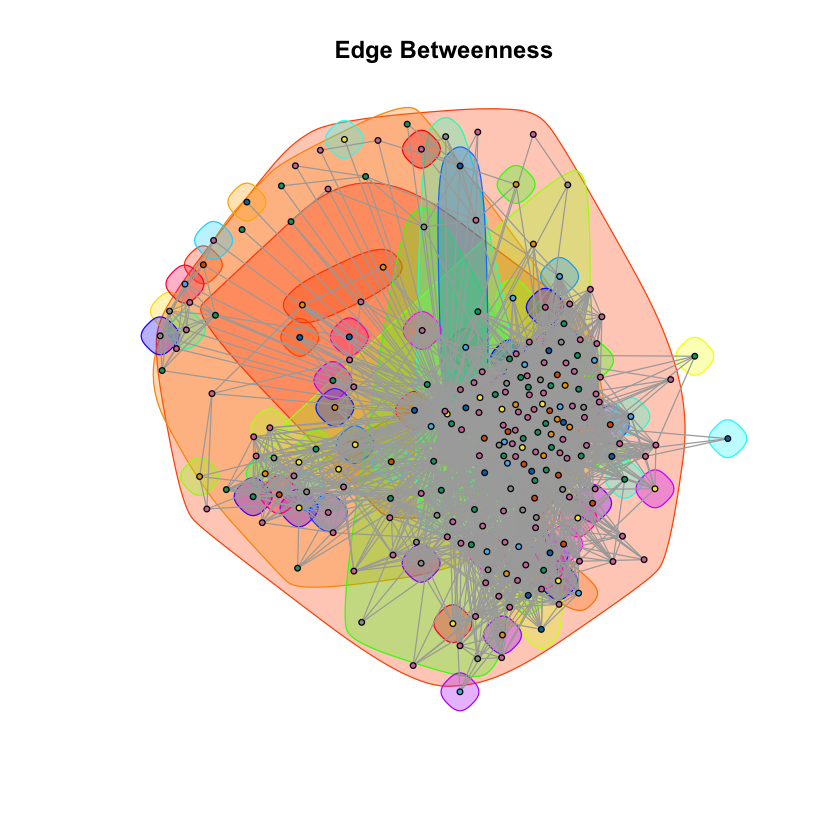

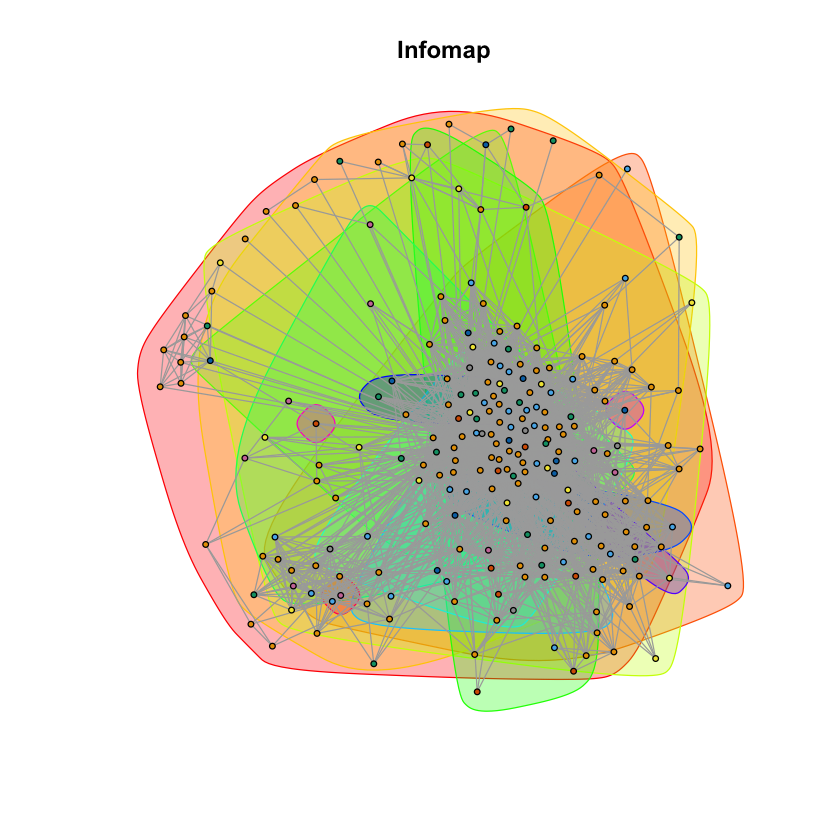

In [7]:
modifiedCommunityStructure(3)

[1] "------------------------------------------------"
[1] "Modularities for Core Node 484's modified Personalized Network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.534214"
[1] "Edge-Betweenness: 0.515441"
[1] "Infomap: 0.543444"


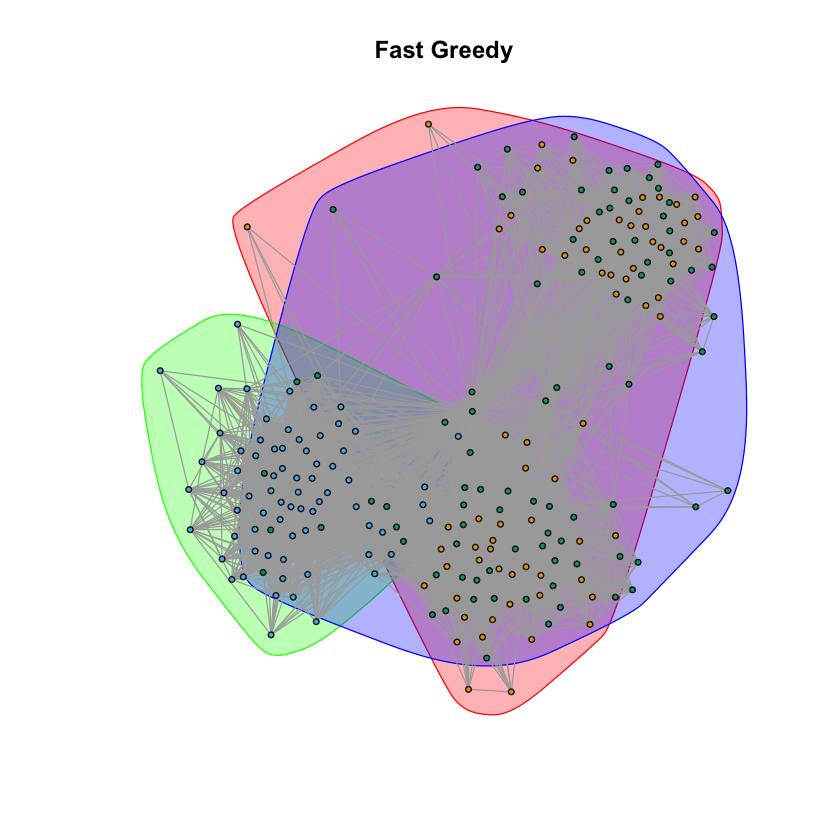

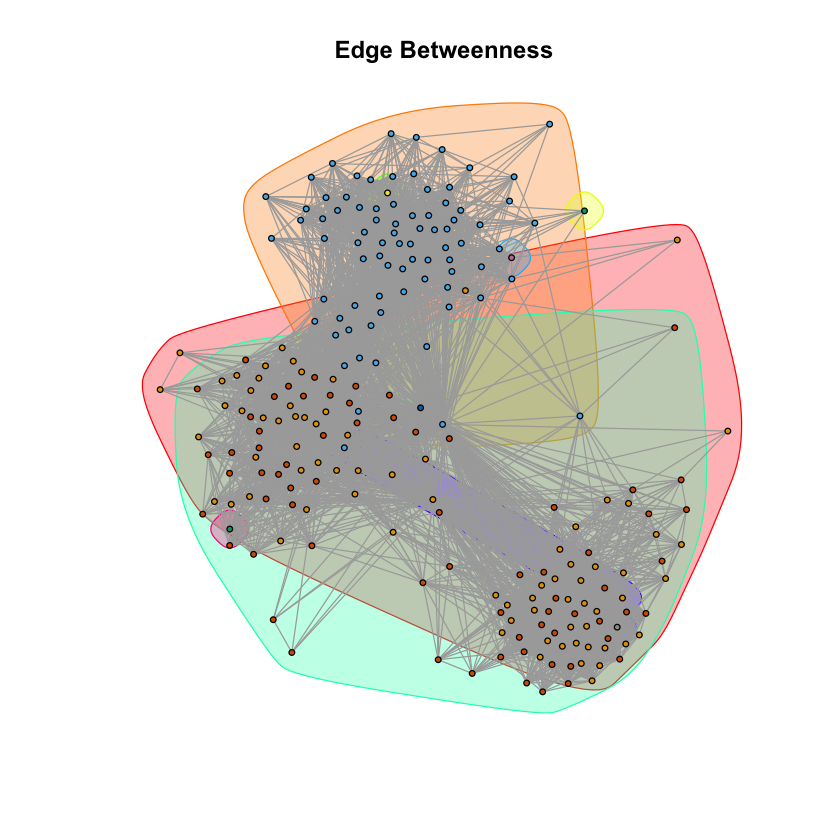

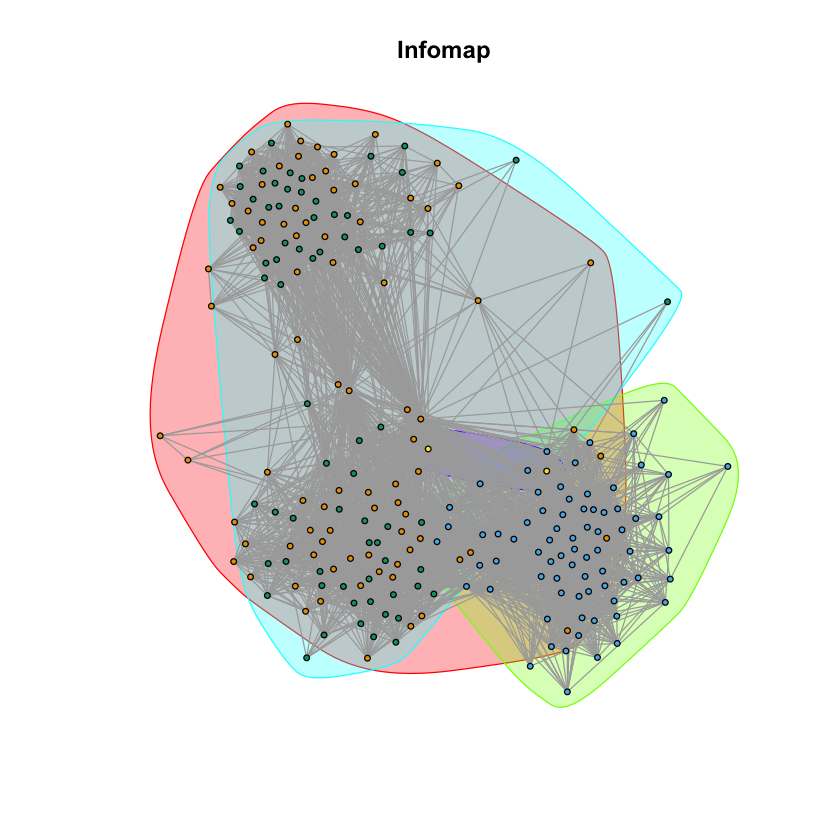

In [8]:
modifiedCommunityStructure(4)

[1] "------------------------------------------------"
[1] "Modularities for Core Node 1087's modified Personalized Network"
[1] "------------------------------------------------"
[1] "Fast Greedy: 0.148196"
[1] "Edge-Betweenness: 0.032495"
[1] "Infomap: 0.027372"


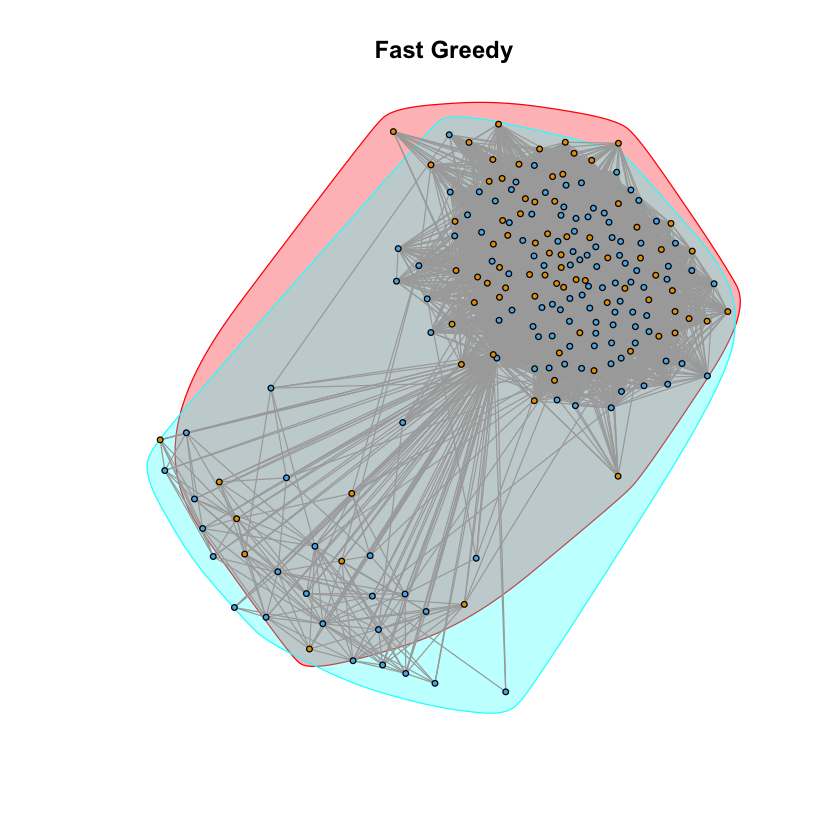

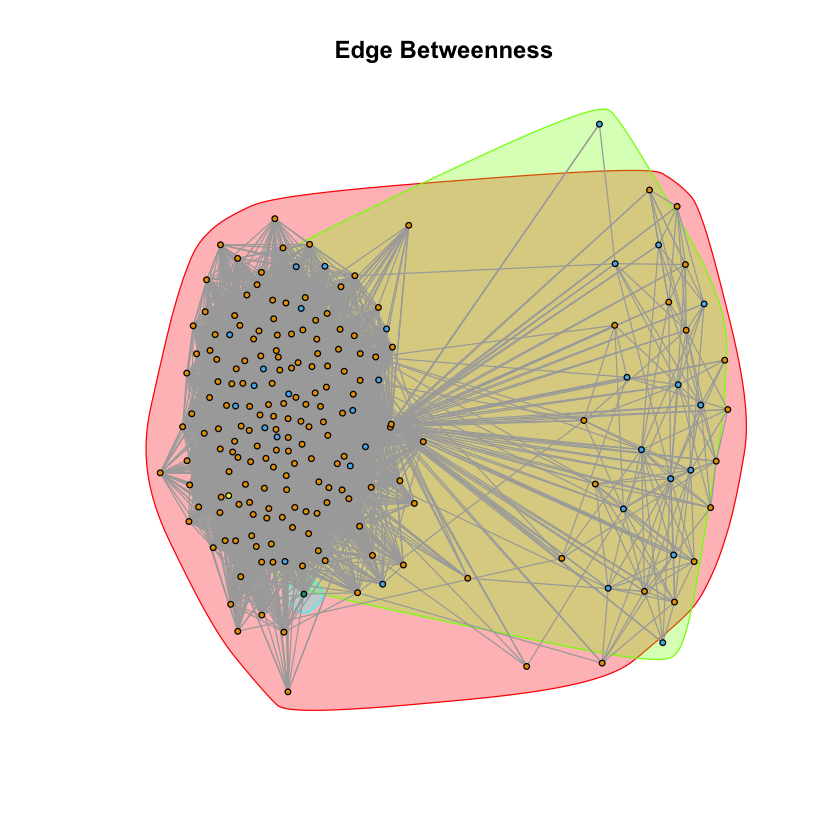

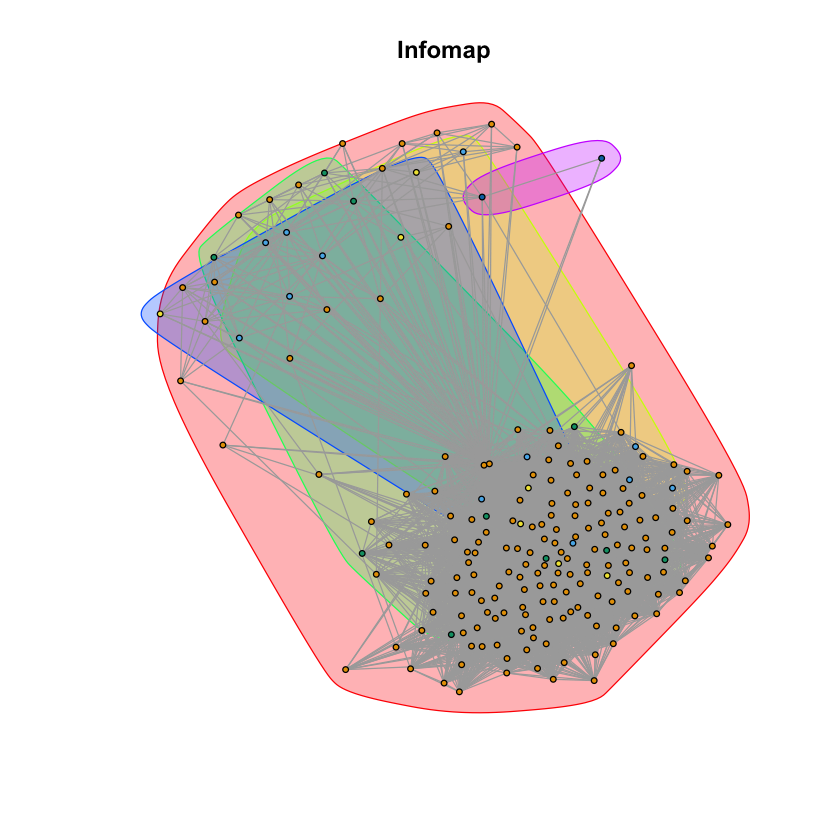

In [9]:
modifiedCommunityStructure(5)

# Question 12

In [12]:
facebook_raw <- read.table("facebook_combined.txt",header=FALSE)
facebook_df <- graph.data.frame(facebook_raw, directed=FALSE)
node_list_str = c("0","107","348","483","1086")

In [13]:
distributionHist <- function(i, flag=0) {
    embed <- c()
    disp <- c()
    deg <- c()
    nodes = unlist(ego(facebook_df, order=1, nodes=node_list_str[i]))
    personalizedNetwork = induced.subgraph(facebook_df,nodes)
    personalizedNetwork$name = sort(nodes)
    j=1
    for(v in vertex_attr(personalizedNetwork)$name){ 
        if(v==node_list_str[i])
            next
        disp[j] = 0
        vertexNeighbor = neighbors(personalizedNetwork, node_list_str[i])
        coreNeighbor = neighbors(personalizedNetwork, v)
        inter = intersection(vertexNeighbor, coreNeighbor)
        embed[j] = length(inter)
        deg[j] = degree(personalizedNetwork,v)
        eg2 = delete.vertices(personalizedNetwork, c(node_list_str[i], v))
        if(embed[j]>1){
            ver = c()
            for(l in 1:length(inter)){
                ver =  c(ver,vertex_attr(personalizedNetwork)$name[inter[l]])
            }
            ver1=c()
            for(l in 1:length(ver)){
                ver1=c(ver1,which(vertex_attr(eg2)$name==ver[l]))
            }
            disp_mat = distances(eg2,v=ver1, to=ver1)
            disp_mat[disp_mat==Inf]<-diameter(eg2)+1
            disp[j] = sum(disp_mat)
        }
        j=j+1
        
    }
    if (flag == 0) {
        hist(embed,main=sprintf("Embeddedness Histogram of Node %d",strtoi(node_list_str[i])+1), xlab="Embeddedness",ylab="Count")
        hist(disp,main=sprintf("Dispersion Histogram of Node %d",strtoi(node_list_str[i])+1), xlab="Dispersion",ylab="Count")
    }
    else if (flag == 1) {
        maxdisp = personalizedNetwork$name[which(disp==max(disp))]
        maxnode = which(personalizedNetwork$name==maxdisp)

        fast_greedy <- cluster_fast_greedy(personalizedNetwork)
        vert_col = fast_greedy$membership+1
        vert_col[maxnode] = "purple"
        vert_size = rep(3, length(vert_col))
        vert_size[maxnode] = 5
        edge_col = rep("grey", length(E(personalizedNetwork)))
        edge_col[which(get.edgelist(personalizedNetwork, name = FALSE)[,1] == maxnode | get.edgelist(personalizedNetwork, name = FALSE)[,2] == maxnode)] = "purple"
        edge_wid = rep(0.5,length(E(personalizedNetwork)))
        edge_wid[which(get.edgelist(personalizedNetwork, name = FALSE)[,1] == maxnode |  get.edgelist(personalizedNetwork, name = FALSE)[,2] == maxnode)] = 2;
        plot(personalizedNetwork,mark.groups = fast_greedy,vertex.size=vert_size,edge.arrow.size=.5,vertex.color=vert_col,edge.color = edge_col,edge.width=edge_wid,
             vertex.label="",main = sprintf("Community Structure of Fast Greedy with Node %d",strtoi(node_list_str[i])+1))
        legend('topright', legend = c("Max Dispersion", "Incident Edges"), lty = c(0, 1), lwd = c(5,3), pch=c(16,NA), col = c('purple','purple'), pt.cex=3)
        print(sprintf("Core Node %d has a Corresponding Node %d with max Dispersion",strtoi(node_list_str[i])+1,maxnode))
        }
    else if (flag == 2) {
        maxembed = personalizedNetwork$name[which(embed==max(embed))]
        maxnode = which(personalizedNetwork$name==maxembed)

        fast_greedy <- cluster_fast_greedy(personalizedNetwork)
        vert_col = fast_greedy$membership+1
        vert_col[maxnode] = "green"
        vert_size = rep(3, length(vert_col))
        vert_size[maxnode] = 5
        edge_col = rep("grey", length(E(personalizedNetwork)))
        edge_col[which(get.edgelist(personalizedNetwork, name = FALSE)[,1] == maxnode | get.edgelist(personalizedNetwork, name = FALSE)[,2] == maxnode)] = "green"
        edge_wid = rep(0.5,length(E(personalizedNetwork)))
        edge_wid[which(get.edgelist(personalizedNetwork, name = FALSE)[,1] == maxnode |  get.edgelist(personalizedNetwork, name = FALSE)[,2] == maxnode)] = 2;
        plot(personalizedNetwork,mark.groups = fast_greedy,vertex.size=vert_size,edge.arrow.size=.5,vertex.color=vert_col,edge.color = edge_col,edge.width=edge_wid,
             vertex.label="",main = sprintf("Community Structure of Fast Greedy with Node %d",strtoi(node_list_str[i])+1))
        legend('topright', legend = c("Max Embeddedness", "Incident Edges"), lty = c(0, 1), lwd = c(5,3), pch=c(16,NA), col = c('green','green'), pt.cex=3)
        print(sprintf("Core Node %d has a Corresponding Node %d with max Embeddedness",strtoi(node_list_str[i])+1,maxnode))
        }
    else if (flag == 3) {
        ratio = disp/embed
        ratio[mapply(is.nan,ratio)]=0
        maxratio=personalizedNetwork$name[which(ratio==max(ratio))]
        maxnode = which(personalizedNetwork$name==maxratio)

        fast_greedy <- cluster_fast_greedy(personalizedNetwork)
        vert_col = fast_greedy$membership+1
        vert_col[maxnode] = "blue"
        vert_size = rep(3, length(vert_col))
        vert_size[maxnode] = 5
        edge_col = rep("grey", length(E(personalizedNetwork)))
        edge_col[which(get.edgelist(personalizedNetwork, name = FALSE)[,1] == maxnode | get.edgelist(personalizedNetwork, name = FALSE)[,2] == maxnode)] = "blue"
        edge_wid = rep(0.5,length(E(personalizedNetwork)))
        edge_wid[which(get.edgelist(personalizedNetwork, name = FALSE)[,1] == maxnode |  get.edgelist(personalizedNetwork, name = FALSE)[,2] == maxnode)] = 2;
        plot(personalizedNetwork,mark.groups = fast_greedy,vertex.size=vert_size,edge.arrow.size=.5,vertex.color=vert_col,edge.color = edge_col,edge.width=edge_wid,
             vertex.label="",main = sprintf("Community Structure of Fast Greedy with Node %d",strtoi(node_list_str[i])+1))
        legend('topright', legend = c("Max Ratio", "Incident Edges"), lty = c(0, 1), lwd = c(5,3), pch=c(16,NA), col = c('blue','blue'), pt.cex=3)
        print(sprintf("Core Node %d has a Corresponding Node %d with max Ratio",strtoi(node_list_str[i])+1,maxnode))
    }
}

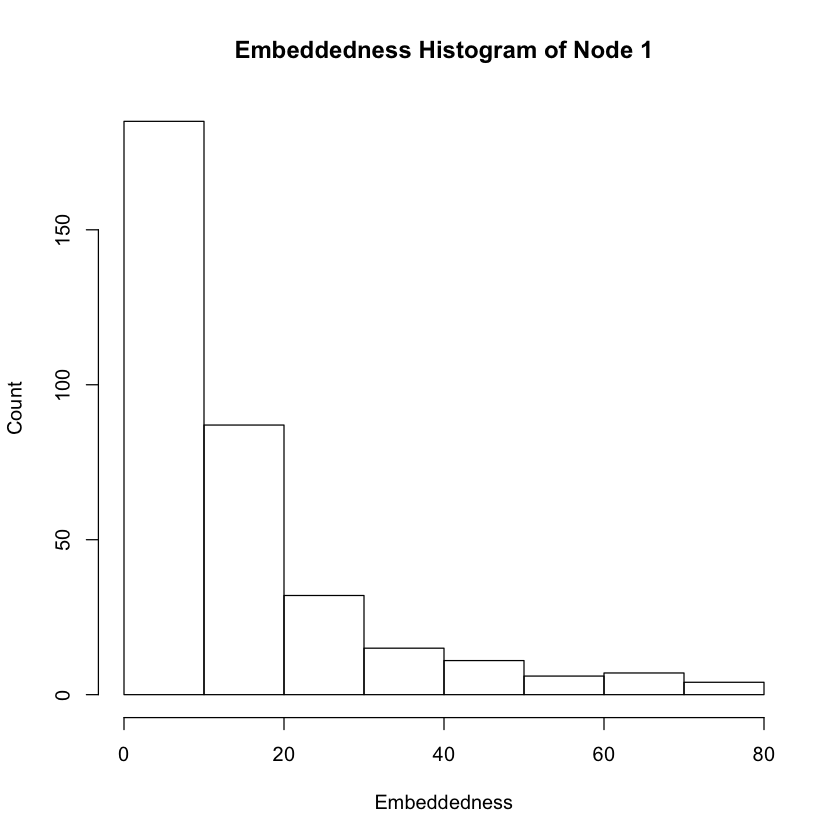

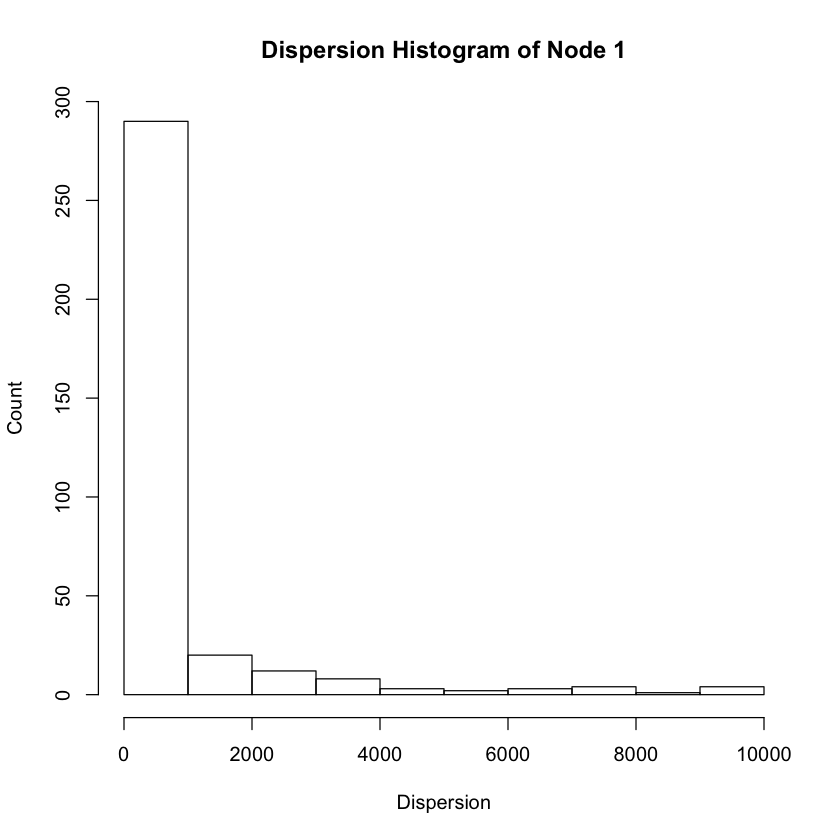

In [53]:
distributionHist(1)

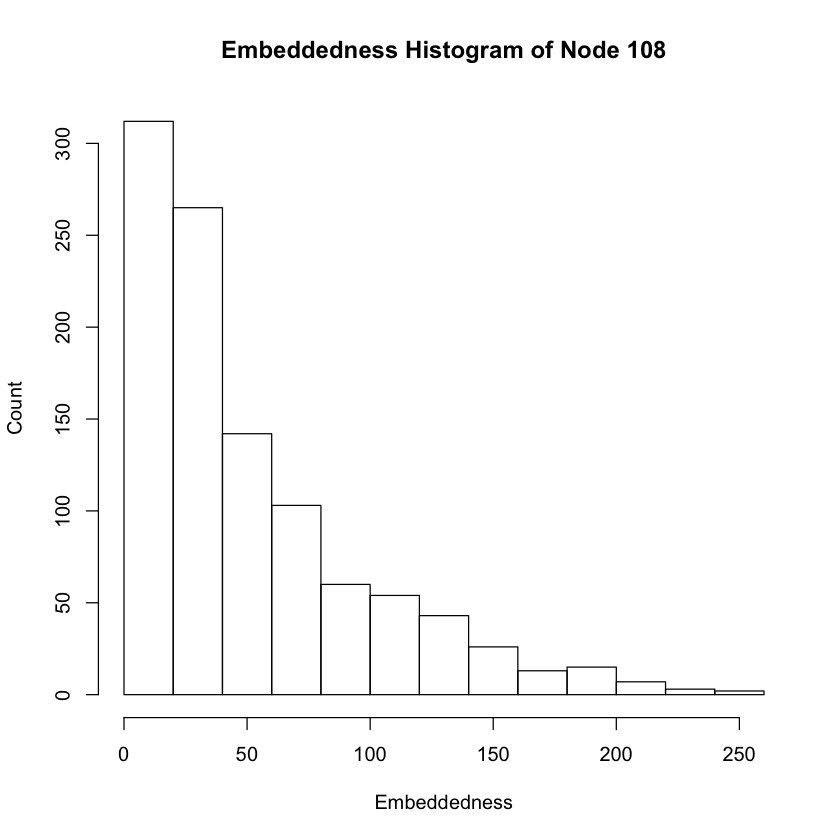

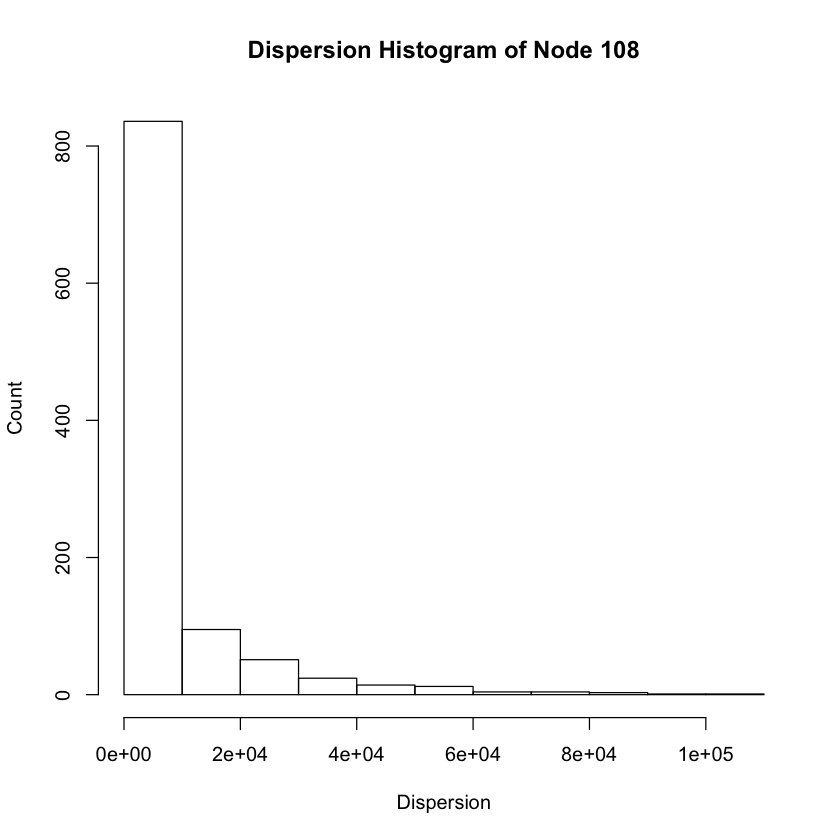

In [44]:
distributionHist(2)

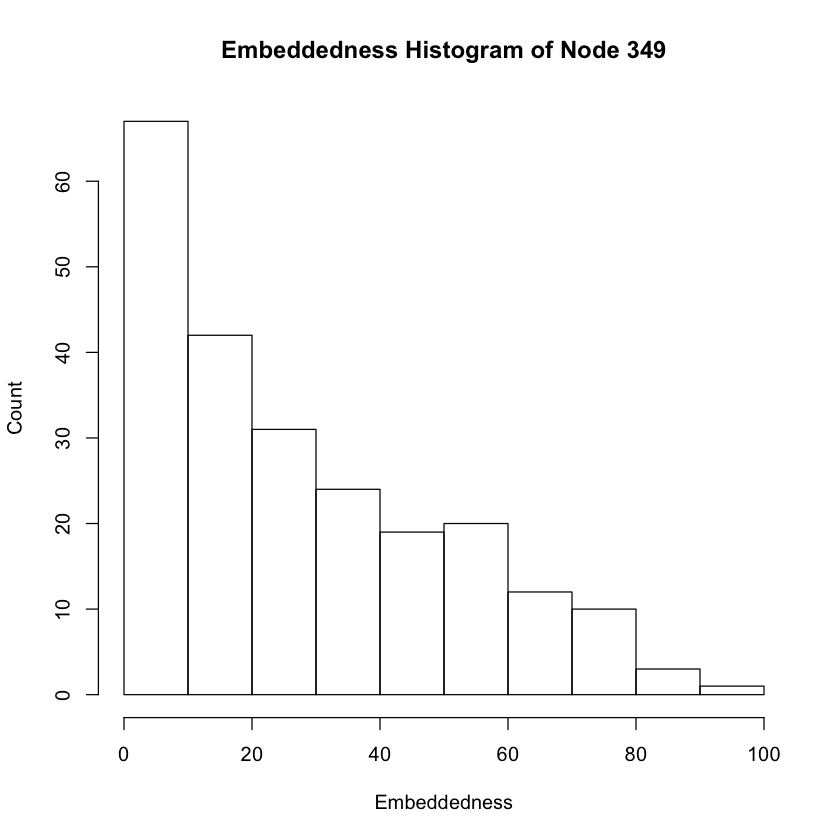

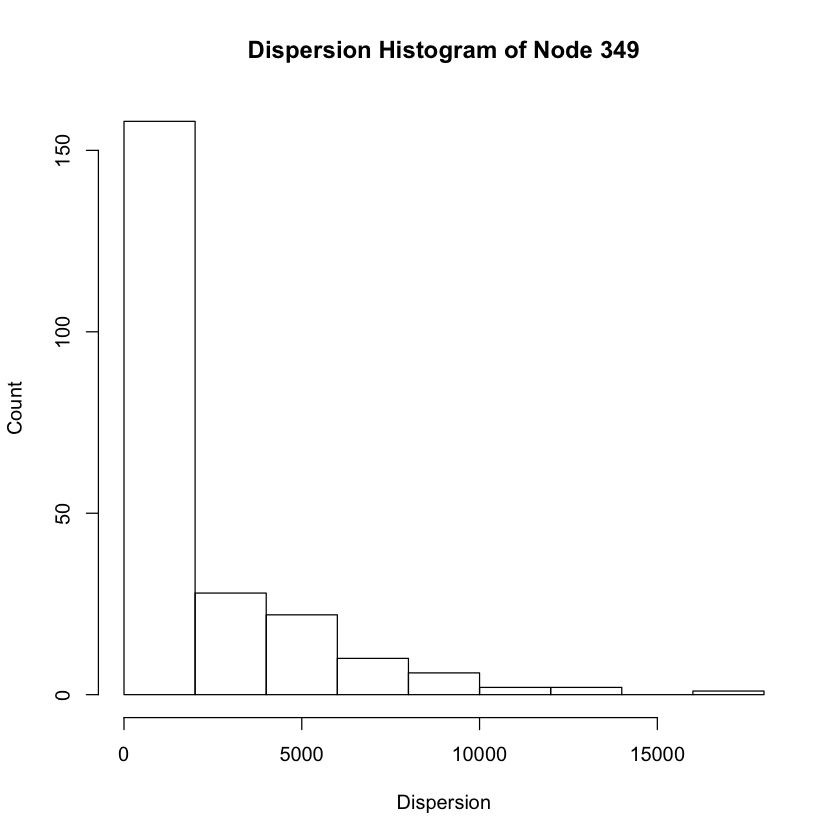

In [45]:
distributionHist(3)

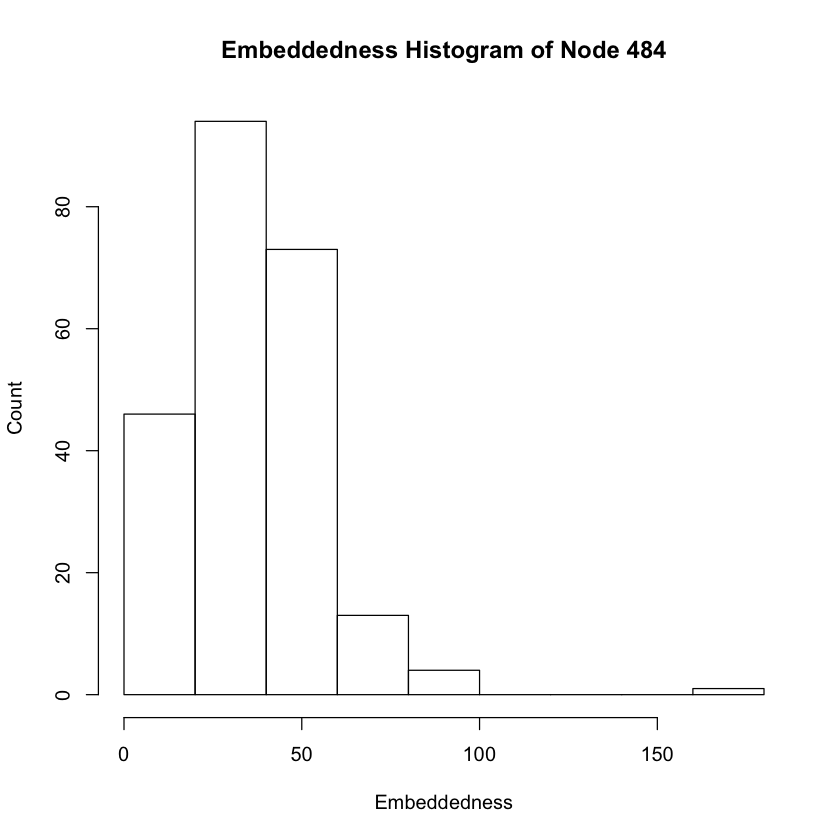

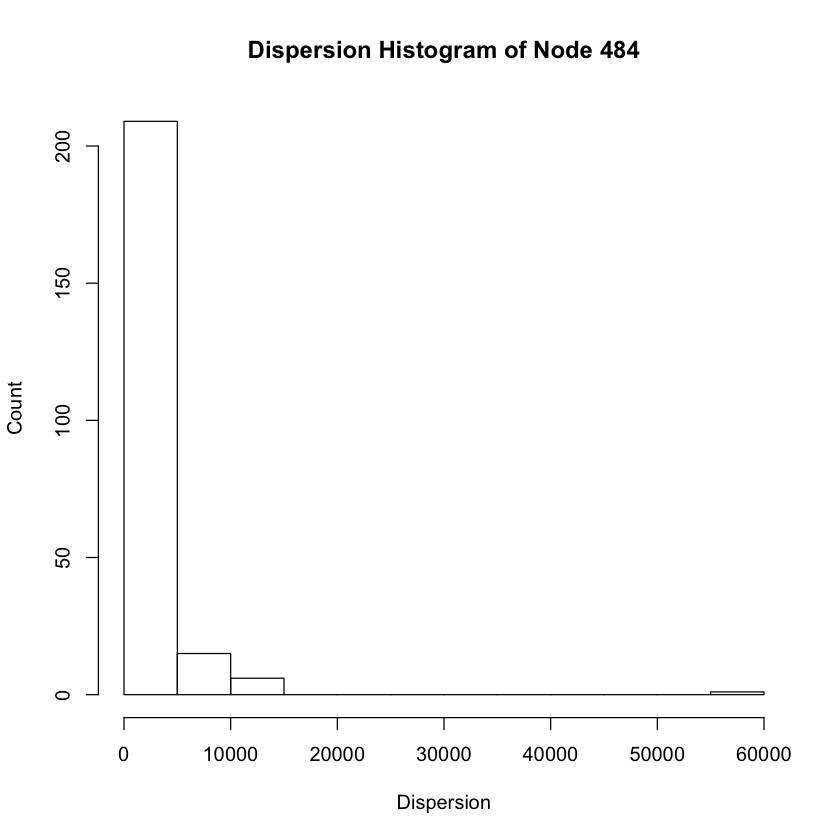

In [46]:
distributionHist(4)

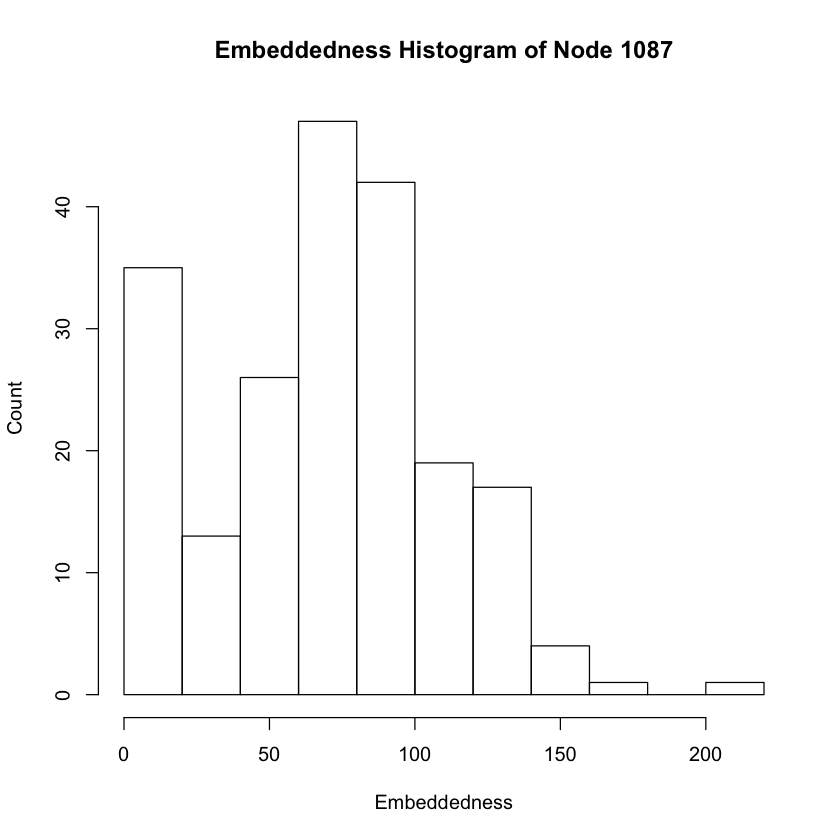

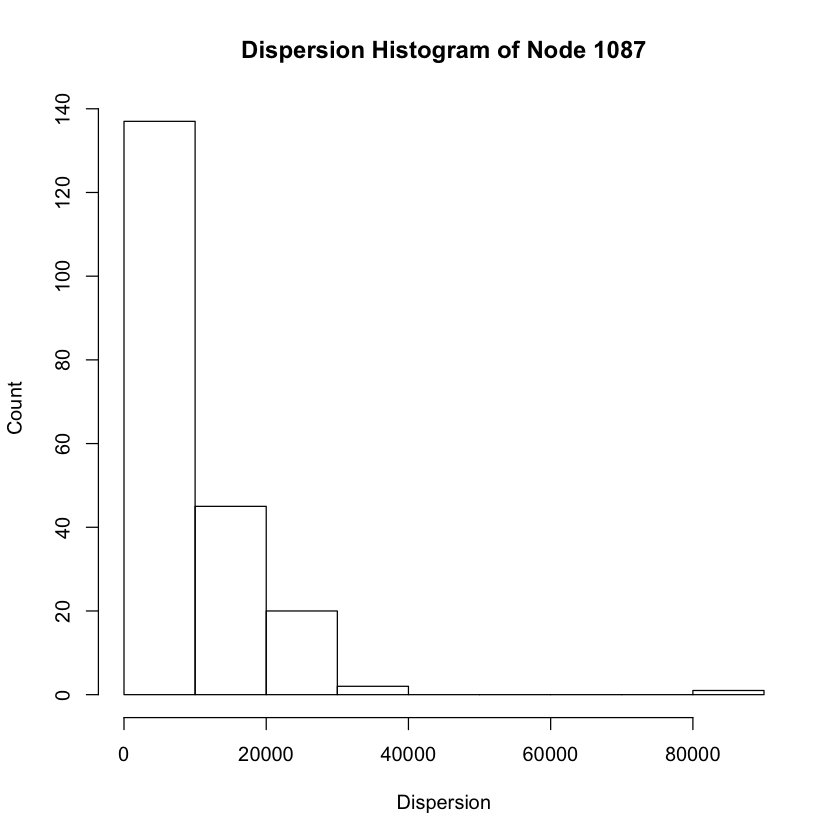

In [47]:
distributionHist(5)

# Question 13

[1] "Core Node 1 has a Corresponding Node 49 with max Dispersion"


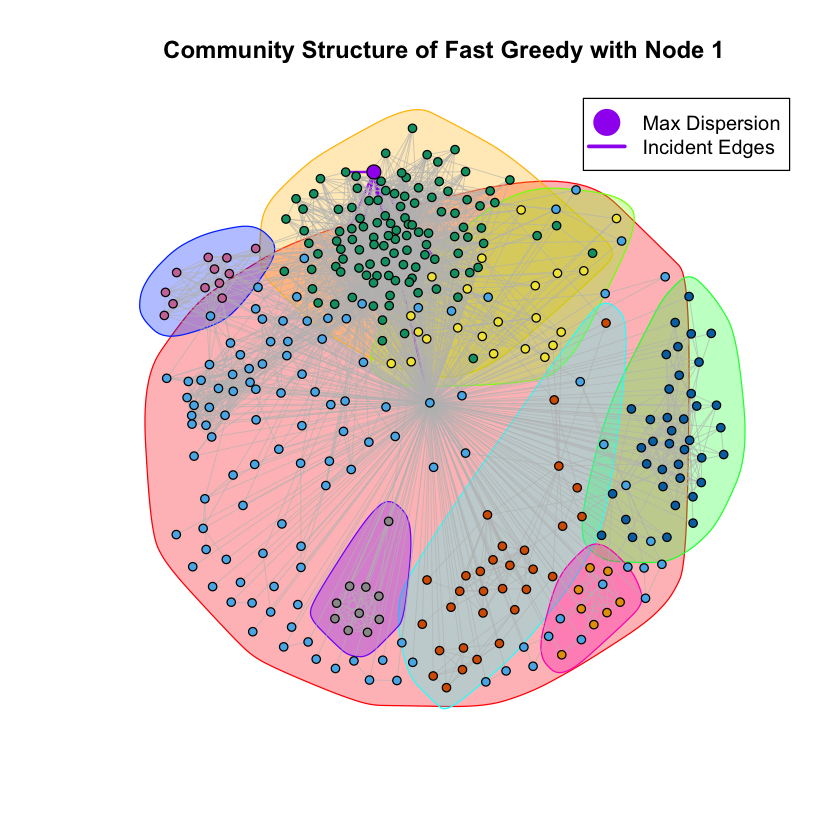

In [95]:
distributionHist(1, flag=1)

[1] "Core Node 108 has a Corresponding Node 977 with max Dispersion"


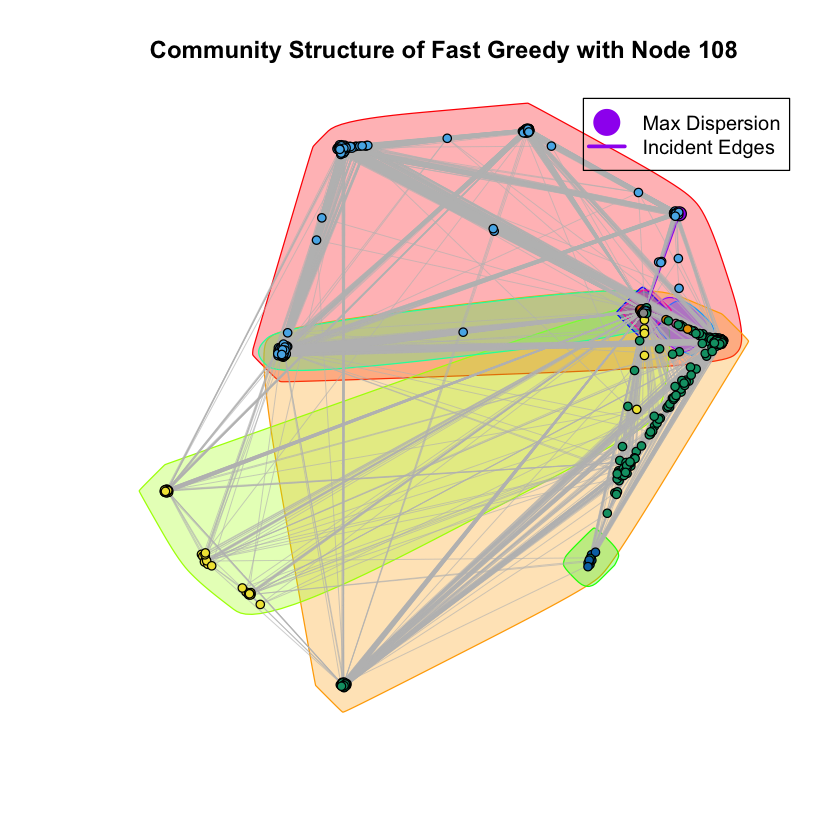

In [96]:
distributionHist(2, flag=1)

[1] "Core Node 349 has a Corresponding Node 31 with max Dispersion"


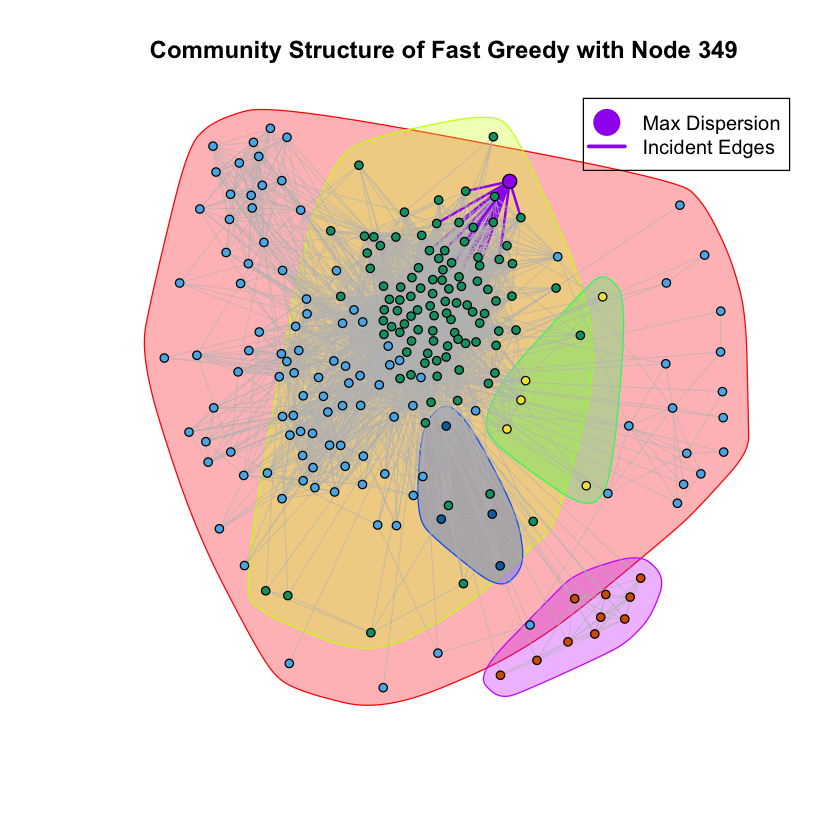

In [97]:
distributionHist(3, flag=1)

[1] "Core Node 484 has a Corresponding Node 1 with max Dispersion"


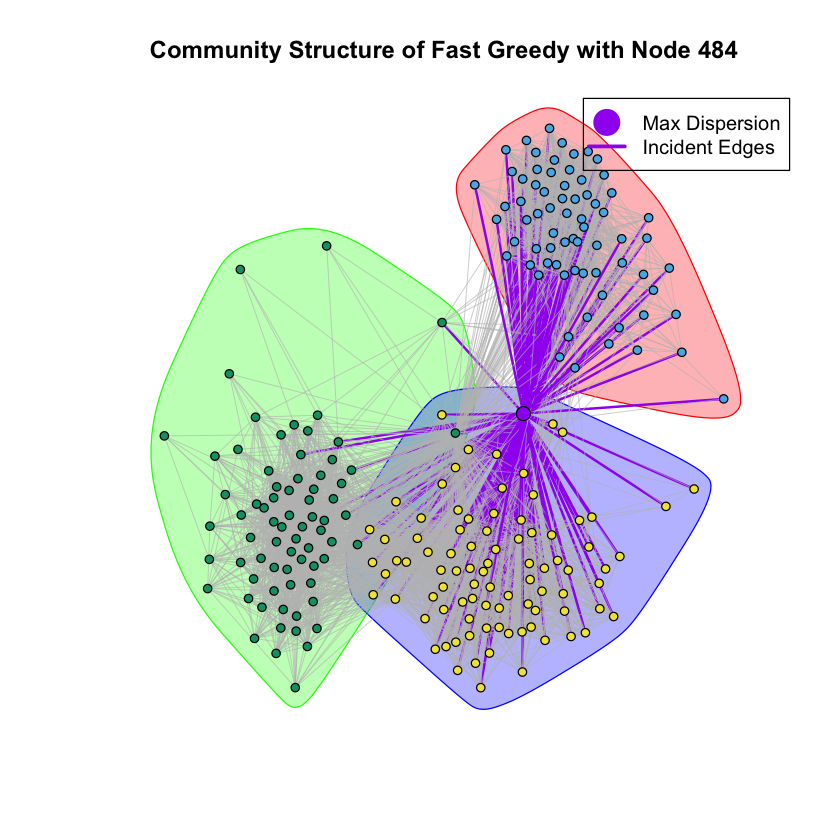

In [98]:
distributionHist(4, flag=1)

[1] "Core Node 1087 has a Corresponding Node 1 with max Dispersion"


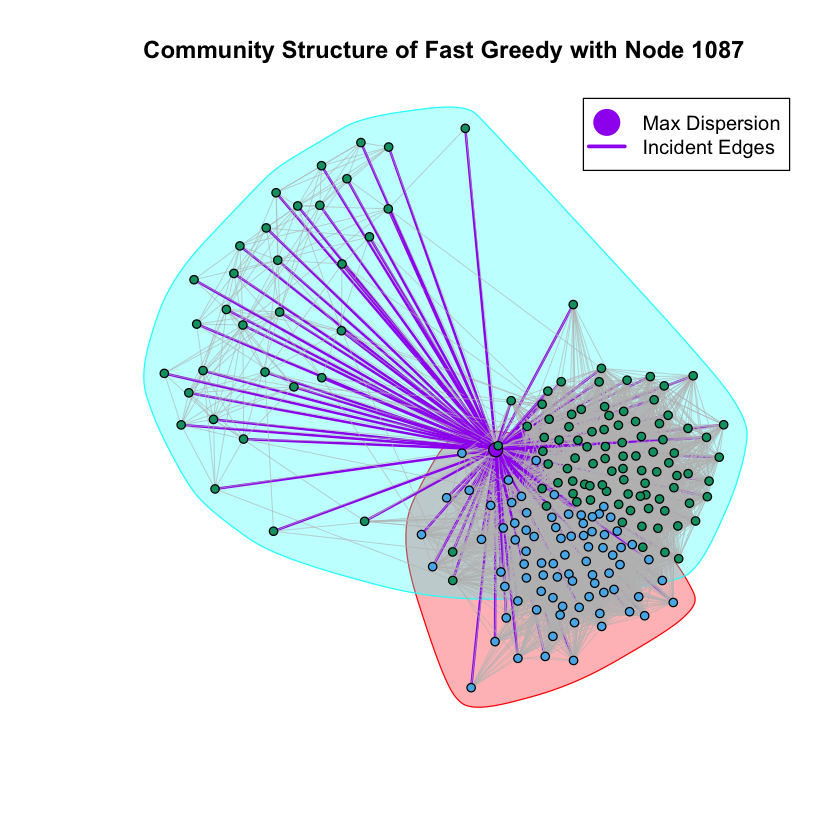

In [99]:
distributionHist(5, flag=1)

# Question 14

[1] "Core Node 1 has a Corresponding Node 49 with max Embeddedness"


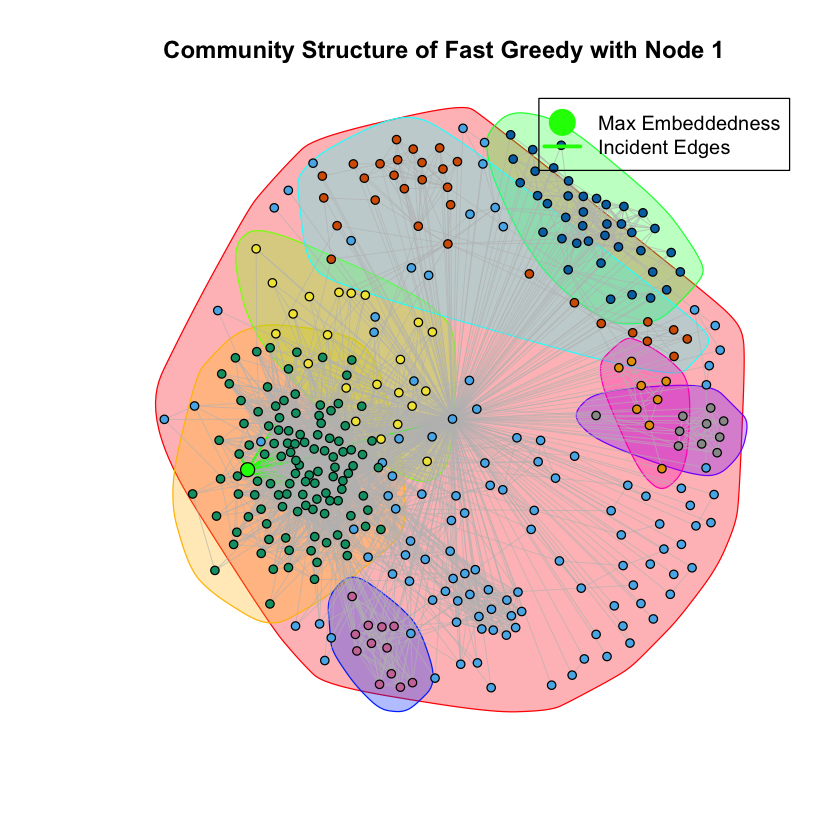

In [14]:
distributionHist(1, flag=2)

[1] "Core Node 108 has a Corresponding Node 977 with max Embeddedness"


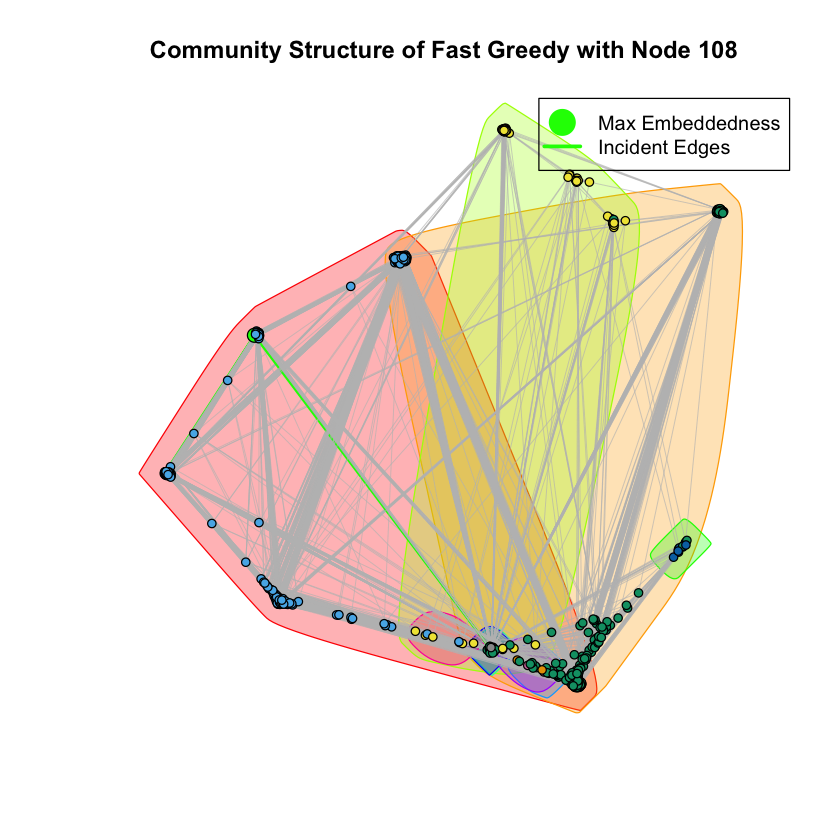

In [15]:
distributionHist(2, flag=2)

[1] "Core Node 349 has a Corresponding Node 31 with max Embeddedness"


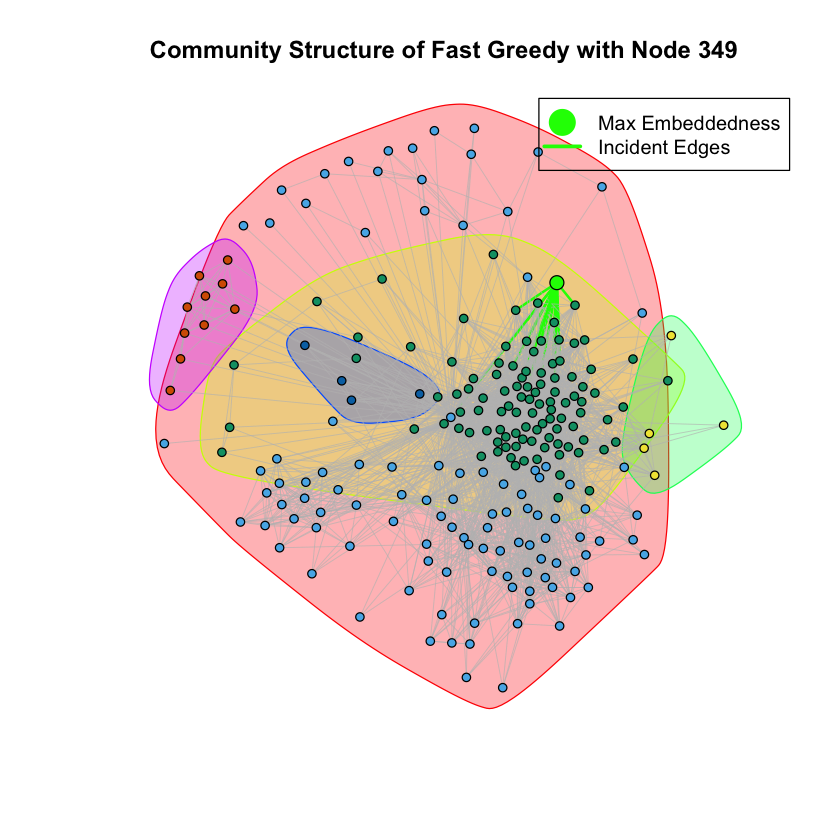

In [16]:
distributionHist(3, flag=2)

[1] "Core Node 484 has a Corresponding Node 1 with max Embeddedness"


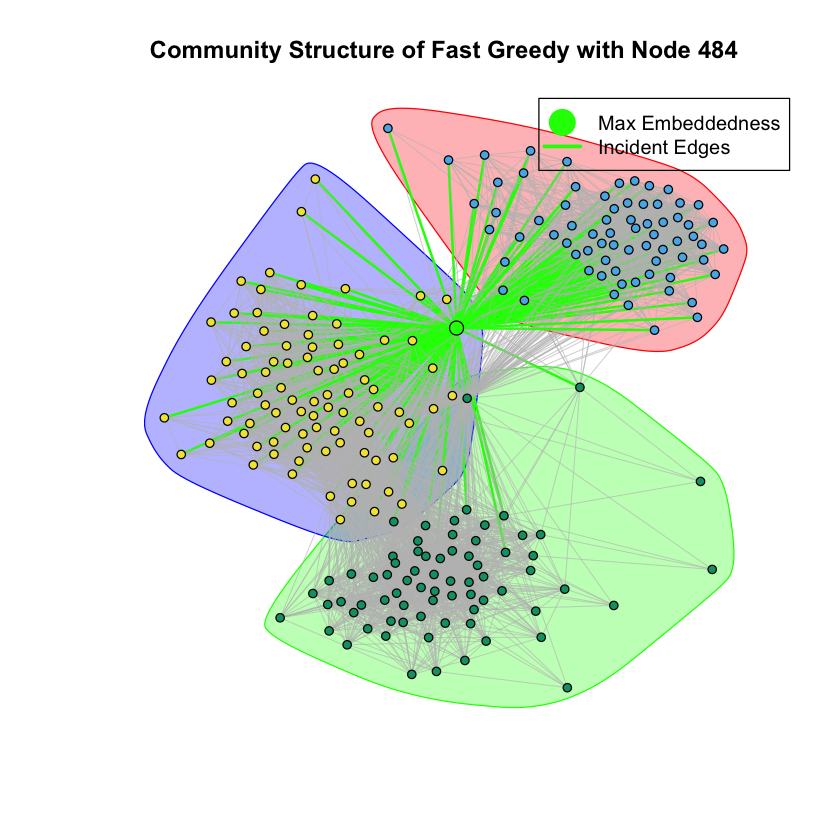

In [17]:
distributionHist(4, flag=2)

[1] "Core Node 1087 has a Corresponding Node 1 with max Embeddedness"


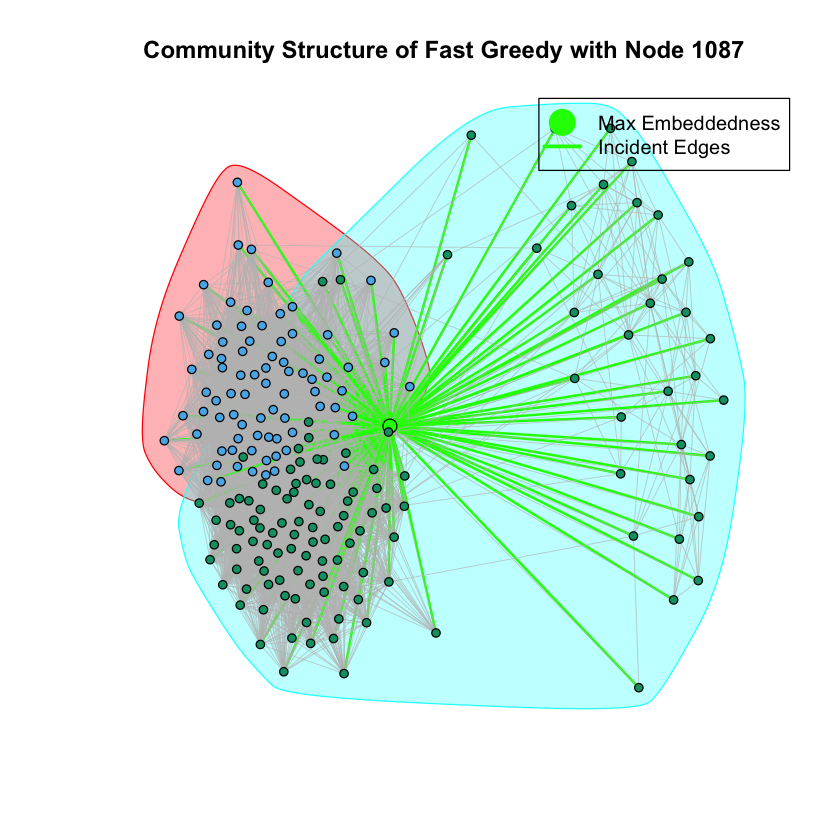

In [18]:
distributionHist(5, flag=2)

[1] "Core Node 1 has a Corresponding Node 21 with max Ratio"


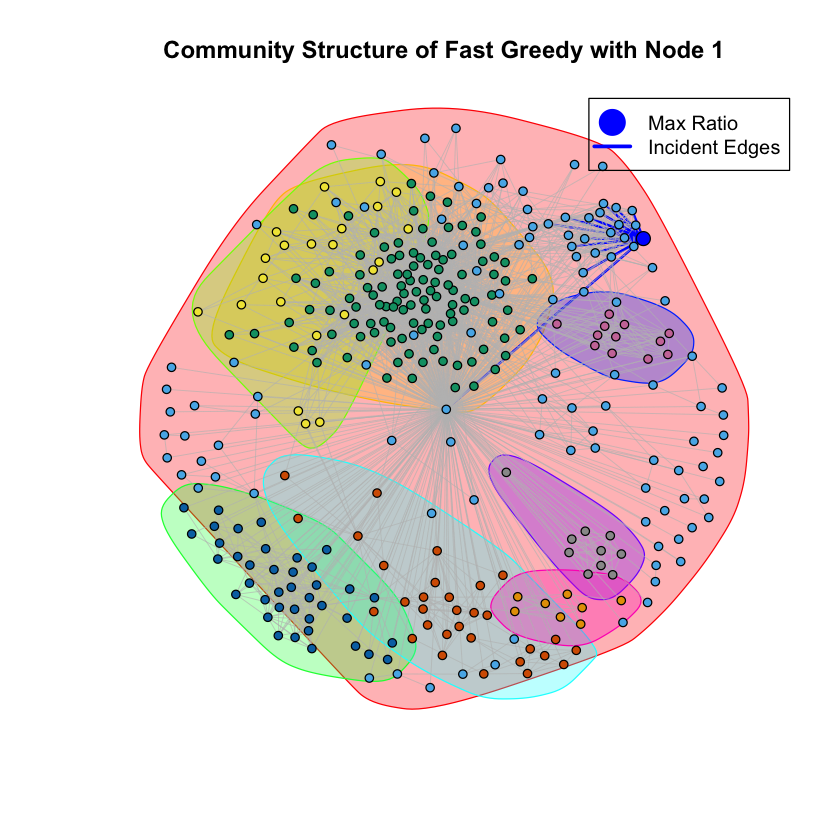

In [19]:
distributionHist(1, flag=3)

[1] "Core Node 108 has a Corresponding Node 977 with max Ratio"


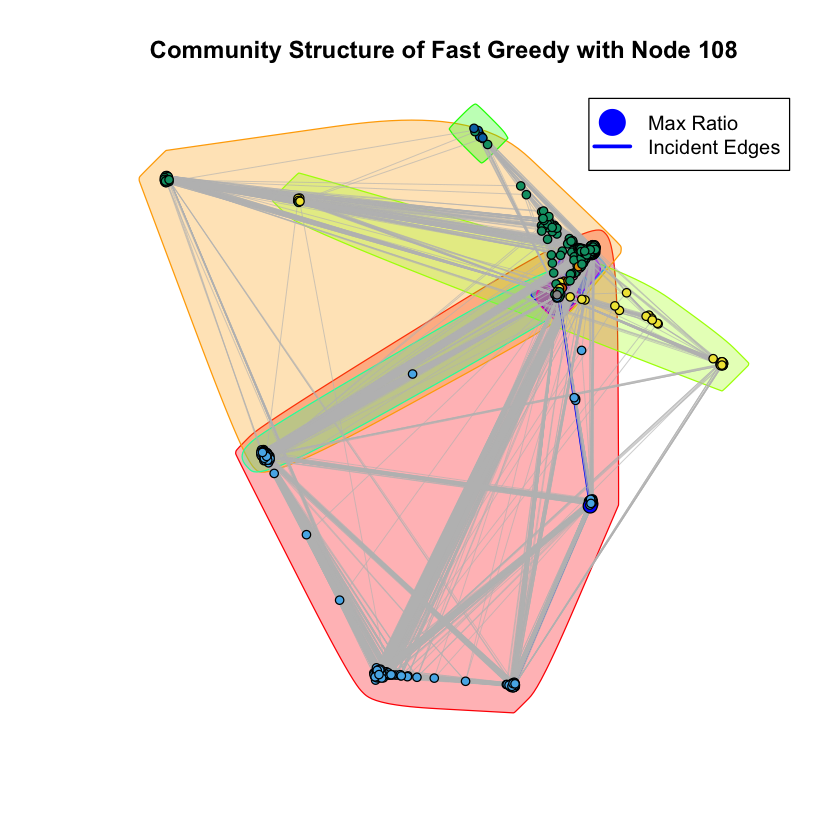

In [20]:
distributionHist(2, flag=3)

[1] "Core Node 349 has a Corresponding Node 31 with max Ratio"


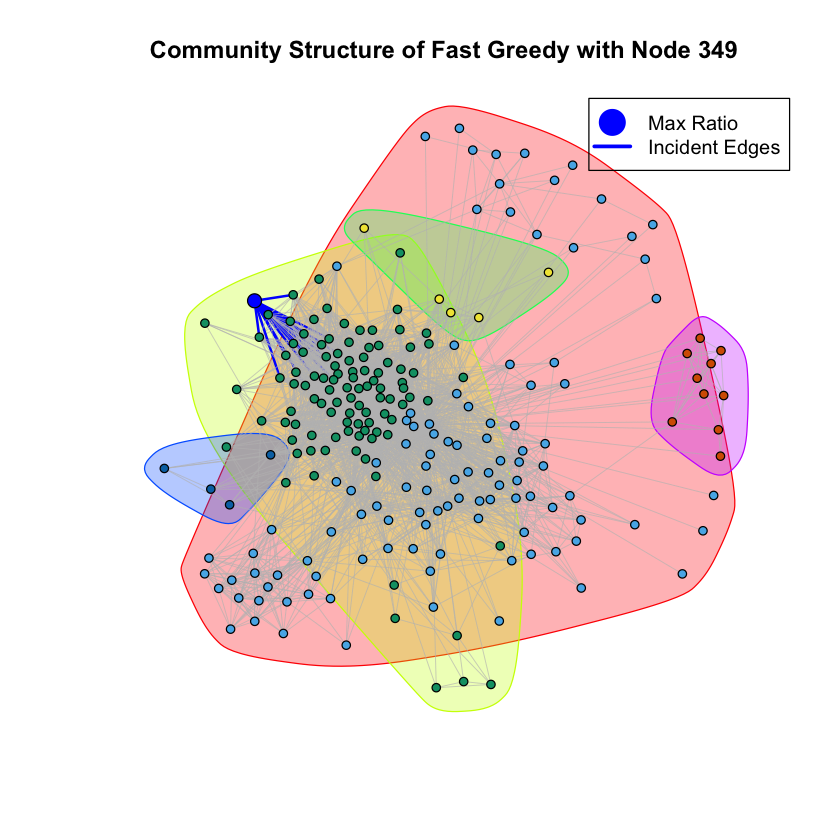

In [21]:
distributionHist(3, flag=3)

[1] "Core Node 484 has a Corresponding Node 1 with max Ratio"


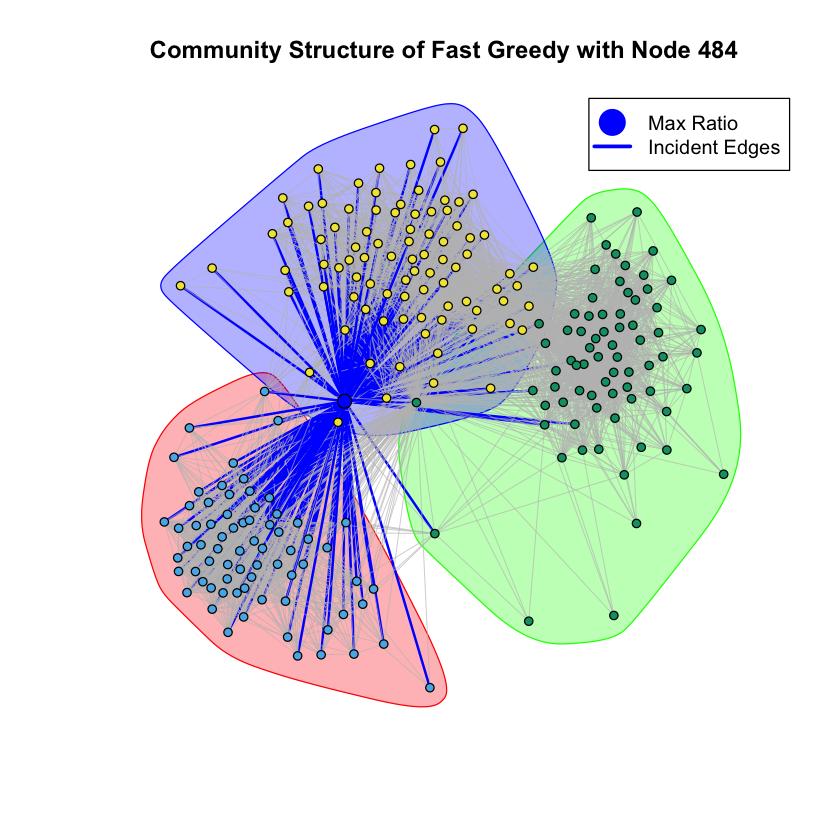

In [22]:
distributionHist(4, flag=3)

[1] "Core Node 1087 has a Corresponding Node 1 with max Ratio"


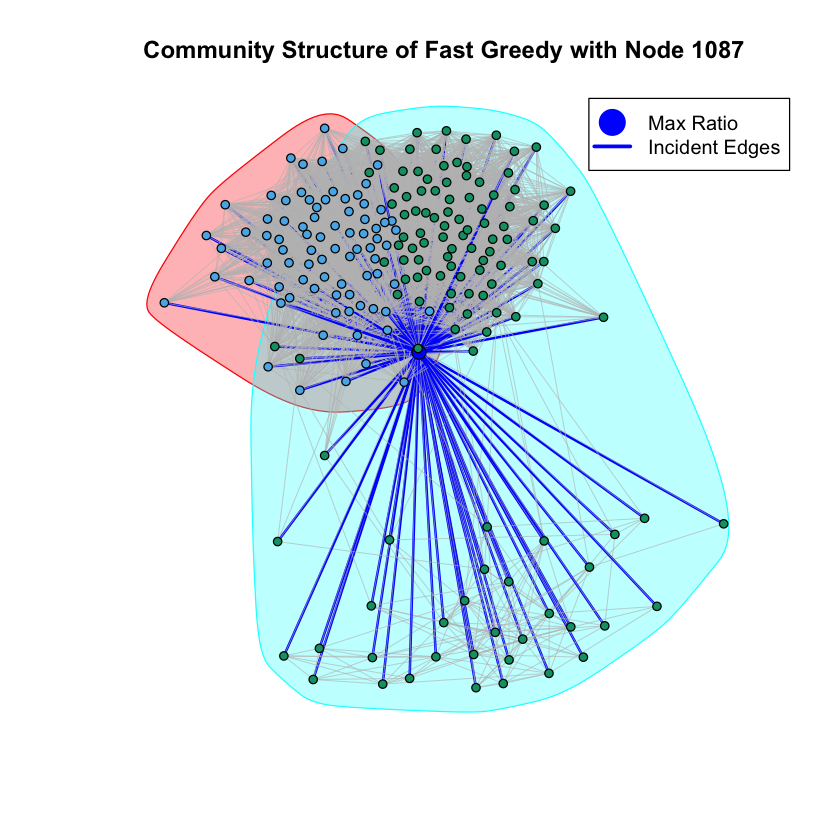

In [23]:
distributionHist(5, flag=3)

# Question 16

In [5]:
facebook_raw <- read.table("facebook_combined.txt")
facebook_df <- graph.data.frame(facebook_raw, directed=FALSE)
personalizedNetwork = make_ego_graph(facebook_df, nodes=c('414'))
Nr = which(degree(personalizedNetwork[[1]]) == 24)
print(length(Nr))

[1] 11


# Question 17

In [28]:
neighborMeasure <- function(graph, i, j, measure='common') {
    n1 <- neighbors(graph, i, mode = c("all"))
    n2 <- neighbors(graph, j, mode = c("all"))
    inter <- intersection(n1, n2)
    if (measure == "common") {
        length(inter)
    }
    else if (measure == "jaccard") {
        length(inter)/(length(n1)+length(n2))
    }
    else if (measure == "adamic") {
        sum <- 0
        for(k in inter) {
            n3 <- neighbors(graph, k, mode = c("all"))
            sum <- sum + 1/(log(length(n3)))
        }
        sum
    }
}

frd_rec <- function(graph, i, neighbor_measure, num_of_recs) {
    measure <- c()
    ver <- V(graph)
    s_i <- neighbors(graph, i, mode = c("all"))
    not_friends <- ver[!ver %in% s_i]
    for(j in not_friends){
        measure <- c(measure, neighborMeasure(graph, i, j, measure=neighbor_measure))
    }
    measure_sorted <- sort(measure, decreasing = TRUE, index.return=TRUE)
    recd_friends <- not_friends[measure_sorted$ix]
    recd_friends[c(1:num_of_recs)]
}
    
recAccuracy <- function(graph, i, p, user_list, neighbor_measure) {
    incident_edges <-incident(graph, v=i, mode = c("all"))
    edges_to_delete <- sample(incident_edges, p*degree(graph,v=i))
    graph2 <- delete_edges(graph, edges_to_delete)
    recommend <- frd_rec(graph2, i, neighbor_measure, length(edges_to_delete))
    for(j in 1:length(recommend)) {
        graph2 <- graph2 + edge(i, recommend[j])
    }
    graph3 <- graph2
    n1 <- neighbors(graph, i, mode = c("all"))
    n2 <- neighbors(graph3, i, mode = c("all"))
    inter <- intersection(n1, n2)
    length(inter)/length(n1)
}

In [32]:
idx <- c()
pnTemp <- personalizedNetwork[[1]]
vertex <- V(pnTemp)
for(i in 1:length(degree(pnTemp))) {
    if(degree(pnTemp, v=i) == 24) {
        idx <- c(idx,i)
    }
}
p <- 0.75
for(measure in c("common", "jaccard", "adamic")) {
    avg <- c()
    for(i in vertex[idx]) {
        sum <- 0
        for(m in 1:10) {
            rec <- recAccuracy(pnTemp, i, p, user_list, measure)
            sum <- sum + rec
        }
        avg <- c(avg, sum/10)
    }
    print(paste("The average accuracy of the friend recommendation algorithm that uses", measure, "is", mean(avg)))
}

[1] "The average accuracy of the friend recommendation algorithm that uses common is 0.882954545454545"
[1] "The average accuracy of the friend recommendation algorithm that uses jaccard is 0.853030303030303"
[1] "The average accuracy of the friend recommendation algorithm that uses adamic is 0.881060606060606"
